<a href="https://colab.research.google.com/github/maverick98/CDS/blob/main/Group4Capstone_Final_25_Apr_2024.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Install Necessary Packages

In [1]:
!pip install wandb
!pip install rouge-score
!pip install jiwer
import nltk
nltk.download('wordnet')
!wandb login

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.0/2.0 MB 27.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 184.3/184.3 kB 14.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 201.7/201.7 kB 6.9 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 62.7/62.7 kB 2.9 MB/s eta 0:00:00
  Created wheel for pathtools: filename=pathtools-0.1.2-py3-none-any.whl size=8807 sha256=c433092293fbe291ff056d8366ffb87a77e05f1349ad63ec4ef1dd8667904df1
  Stored in directory: /root/.cache/pip/wheels/e7/f3/22/152153d6eb222ee7a56ff8617d80ee5207207a8c00a7aab794
Successfully built pathtools
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
  Preparing metadata (setup.py) ... done
  Created wheel for rouge-score: filename=rouge_score-0.1.2-py3-none-any.whl size=24954 sha256=5327ec42763c8

[nltk_data] Downloading package wordnet to /root/nltk_data...


wandb: Logging into wandb.ai. (Learn how to deploy a W&B server locally: https://wandb.me/wandb-server)
wandb: You can find your API key in your browser here: https://wandb.ai/authorize
wandb: Paste an API key from your profile and hit enter, or press ctrl+c to quit: 
wandb: Appending key for api.wandb.ai to your netrc file: /root/.netrc


# Paste API key from below



```
# This is formatted as code
```

ea166aa37d5e7c2f0ad3c5fadfe7a4e9f37dfff0

# Import necessary libraries

In [2]:
import numpy as np
import string
import tensorflow as tf
from tensorflow import math, matmul, reshape, shape, transpose, cast, float32
from tensorflow.data import Dataset
from tensorflow.keras.layers import Embedding,Dense, Layer,TextVectorization
from tensorflow.keras.backend import softmax
from pickle import load, dump, HIGHEST_PROTOCOL
from sklearn.utils import shuffle
from numpy import savetxt
from tensorflow.keras.preprocessing.text import Tokenizer
from tensorflow.keras.preprocessing.sequence import pad_sequences
from tensorflow import convert_to_tensor, int64
from tensorflow.keras.layers import LayerNormalization,   ReLU, Dropout
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.optimizers.schedules import LearningRateSchedule
from tensorflow.keras.metrics import Mean
from tensorflow import data, train,  reduce_sum,  equal, argmax,GradientTape, function
from tensorflow.keras.losses import sparse_categorical_crossentropy

from time import time
from pickle import dump
from tensorflow import    linalg, ones, maximum, newaxis
from tensorflow.keras import Model
from pickle import load
from tensorflow import Module
from tensorflow import   TensorArray, argmax,  transpose
from matplotlib.pylab import plt
from numpy import arange

from keras.utils import to_categorical
import numpy as np
from numpy import array
import pandas as pd
import cv2
from glob import glob
import PIL
#import time
from tqdm import tqdm
import os
#import gensim
from sklearn.model_selection import train_test_split
from nltk.translate.bleu_score import sentence_bleu
from PIL import Image
import random
from importlib.machinery import SourceFileLoader
from os.path import join
from google.colab import drive
from nltk.translate.bleu_score import sentence_bleu
from nltk.translate.bleu_score import SmoothingFunction

# Check if connected to GPU

In [ ]:
gpu_info = !nvidia-smi
gpu_info = '\n'.join(gpu_info)
if gpu_info.find('failed') >= 0:
  print('Not connected to a GPU')
else:
  print(gpu_info)

Sun Apr 23 03:49:59 2023       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 525.85.12    Driver Version: 525.85.12    CUDA Version: 12.0     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla T4            Off  | 00000000:00:04.0 Off |                    0 |
| N/A   35C    P8     9W /  70W |      0MiB / 15360MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

# Mount Google Drive

In [3]:


ROOT = "/content/drive"
drive.mount(ROOT,force_remount=True)




Mounted at /content/drive


# Download the flickr8k dataset

In [ ]:
#Uncomment for the first time.
!wget  https://github.com/jbrownlee/Datasets/releases/download/Flickr8k/Flickr8k_Dataset.zip
!wget https://github.com/jbrownlee/Datasets/releases/download/Flickr8k/Flickr8k_text.zip

In [5]:
PROJ = "MyDrive/Capstone/src" 
PROJECT_PATH = join(ROOT, PROJ)
print("PROJECT_PATH from your Google Drive is ",PROJECT_PATH)
!rm -rf "{PROJECT_PATH}"
!mkdir  "{PROJECT_PATH}"

PROJECT_PATH from your Google Drive is  /content/drive/MyDrive/Capstone/src


# Store it under dataset directory

In [6]:
CUR_DIR='/content'


In [7]:
!rm -rf {CUR_DIR}/dataset
!mkdir -p {CUR_DIR}/dataset/images
!mkdir -p {CUR_DIR}/dataset/texts
!unzip  {CUR_DIR}/Flickr8k_text.zip -d {CUR_DIR}/dataset/texts
!unzip {CUR_DIR}/Flickr8k_Dataset.zip -d {CUR_DIR}/dataset/images
!rm -rf /content/group4capstone-code

Streaming output truncated to the last 5000 lines.
  inflating: /content/dataset/images/__MACOSX/Flicker8k_Dataset/._342872408_04a2832a1b.jpg  
  inflating: /content/dataset/images/Flicker8k_Dataset/3429142249_d09a32e291.jpg  
  inflating: /content/dataset/images/__MACOSX/Flicker8k_Dataset/._3429142249_d09a32e291.jpg  
  inflating: /content/dataset/images/Flicker8k_Dataset/3429194423_98e911a101.jpg  
  inflating: /content/dataset/images/__MACOSX/Flicker8k_Dataset/._3429194423_98e911a101.jpg  
  inflating: /content/dataset/images/Flicker8k_Dataset/3429351222_17ae744daf.jpg  
  inflating: /content/dataset/images/__MACOSX/Flicker8k_Dataset/._3429351222_17ae744daf.jpg  
  inflating: /content/dataset/images/Flicker8k_Dataset/3429351964_531de1bf16.jpg  
  inflating: /content/dataset/images/__MACOSX/Flicker8k_Dataset/._3429351964_531de1bf16.jpg  
  inflating: /content/dataset/images/Flicker8k_Dataset/3429391520_930b153f94.jpg  
  inflating: /content/dataset/images/__MACOSX/Flicker8k_Dataset/.

# Clone the code from https://sourceforge.net/projects/group4capstone/

In [8]:
%cd "{PROJECT_PATH}"
!pwd
!rm -rf /content/drive/MyDrive/Capstone/src/group4capstone-code
MY_USER_NAME = 'msahu98' # This is your sourceforge.net username
!git clone https://{MY_USER_NAME}@git.code.sf.net/p/group4capstone/code group4capstone-code
%cd {CUR_DIR}

/content/drive/MyDrive/Capstone/src
/content/drive/MyDrive/Capstone/src
Cloning into 'group4capstone-code'...
remote: Enumerating objects: 1408, done.
remote: Counting objects: 100% (1408/1408), done.
remote: Compressing objects: 100% (1176/1176), done.
remote: Total 1408 (delta 719), reused 0 (delta 0)
Receiving objects: 100% (1408/1408), 282.72 MiB | 3.66 MiB/s, done.
Resolving deltas: 100% (719/719), done.
Updating files: 100% (48/48), done.
/content


# Load Modules

In [19]:
!pwd

/content


In [20]:
def load_module(module_name,module_path):
    module_py=module_name+'.py'
    SourceFileLoader(module_name, join(join(PROJECT_PATH,'group4capstone-code/src/',module_path), module_py)).load_module()



In [21]:
import pathlib,sys,os

sys.path.append(os.path.dirname(join(PROJECT_PATH,'group4capstone-code/')))

In [22]:
load_module('positional_encoding','model/transformer')
load_module('multihead_attention','model/transformer')
load_module('add_normalization','model/transformer')
load_module('feedforward','model/transformer')
load_module('encoder','model/transformer')
load_module('decoder','model/transformer')
load_module('learning_rate_schedule','model/transformer')
load_module('model_params','model/params')
load_module('model_params_factory','model/params')
load_module('model_training_params','model/params')
load_module('model_training_params_factory','model/params')
load_module('transformer','model/transformer')
load_module('caption_processor','model/data')
load_module('cnn_model','model/data')
load_module('image_caption_dataset','model/data')
load_module('metric','model/metric')
load_module('inference','evaluate')
load_module('train','train')
load_module('evaluate','evaluate')


In [23]:
!pip3 freeze

absl-py==1.4.0
alabaster==0.7.13
albumentations==1.2.1
altair==4.2.2
anyio==3.6.2
appdirs==1.4.4
argon2-cffi==21.3.0
argon2-cffi-bindings==21.2.0
arviz==0.15.1
astropy==5.2.2
astunparse==1.6.3
attrs==23.1.0
audioread==3.0.0
autograd==1.5
Babel==2.12.1
backcall==0.2.0
beautifulsoup4==4.11.2
bleach==6.0.0
blis==0.7.9
blosc2==2.0.0
bokeh==2.4.3
branca==0.6.0
CacheControl==0.12.11
cached-property==1.5.2
cachetools==5.3.0
catalogue==2.0.8
certifi==2022.12.7
cffi==1.15.1
chardet==4.0.0
charset-normalizer==2.0.12
chex==0.1.7
click==8.1.3
cloudpickle==2.2.1
cmake==3.25.2
cmdstanpy==1.1.0
colorcet==3.0.1
colorlover==0.3.0
community==1.0.0b1
confection==0.0.4
cons==0.4.5
contextlib2==0.6.0.post1
contourpy==1.0.7
convertdate==2.4.0
cryptography==40.0.2
cufflinks==0.17.3
cupy-cuda11x==11.0.0
cvxopt==1.3.0
cvxpy==1.3.1
cycler==0.11.0
cymem==2.0.7
Cython==0.29.34
dask==2022.12.1
datascience==0.17.6
db-dtypes==1.1.1
dbus-python==1.2.16
debugpy==1.6.6
decorator==4.4.2
defusedxml==0.7.1
distributed==20

# Import image caption libs

In [24]:
from caption_processor import CaptionProcessor
from cnn_model import CNN_Model
from image_caption_dataset import ImageCaptionDataset
from transformer import Transformer
from model_params import TransformerModelParams
from model_training_params import TransformerTrainingParams
from positional_encoding import create_masks_decoder
from inference import Inference
from model_params_factory import ModelParamsFactory
from model_training_params_factory import ModelTrainingParamsFactory
from evaluate import Evaluate
from train import Train



# Initialize model parameters

In [25]:
modelParamsFactory = ModelParamsFactory()
model_params=modelParamsFactory.create()

modelTrainingParamsFactory = ModelTrainingParamsFactory()
model_training_params=modelTrainingParamsFactory.create()
train_image_caption_path=model_training_params.train_image_caption_path
test_image_caption_path=model_training_params.test_image_caption_path


In [26]:
model_params.toJSON()

'{\n    "attn_col_size": 8,\n    "attn_row_size": 8,\n    "caption_max_len": 33,\n    "d_ff": 2048,\n    "d_k": 64,\n    "d_model": 512,\n    "d_v": 64,\n    "dropout_rate": 0.1,\n    "h": 8,\n    "max_pos_encoding": 8358,\n    "num_layers": 6,\n    "target_vocab_size": 8358\n}'

In [ ]:
#model_params.dropout_rate=0.1
#model_params.caption_max_len=20
#model_training_params.caption_max_len=20


In [27]:
model_training_params.batch_size,model_training_params.token_file

(128, '/content/dataset/texts/Flickr8k.token.txt')

In [ ]:
#model_training_params.token_file='/content/dataset/texts/Flickr8k.lemma.token.txt'

In [28]:
model_training_params.toJSON()

'{\n    "batch_size": 128,\n    "beta_1": 0.9,\n    "beta_2": 0.98,\n    "caption_max_len": 33,\n    "checkpoints_path": "./checkpoints",\n    "data_limit_test": 5000,\n    "data_limit_train": 30000,\n    "data_limit_val": 5000,\n    "epochs": 100,\n    "epsilon": 1e-09,\n    "glove_dir": "/content/dataset/glove",\n    "glove_embedding_file": "glove.6B.300d.txt",\n    "image_path": "/content/dataset/images/Flicker8k_Dataset/",\n    "max_to_keep": 3,\n    "min_delta": 0.001,\n    "model_output": "/content/drive/MyDrive/Capstone/weights/saved_model",\n    "monitor": "val_loss",\n    "num_words": 8357,\n    "patience": 5,\n    "test_image_caption_path": "/content/drive/MyDrive/Capstone/test_captions",\n    "token_file": "/content/dataset/texts/Flickr8k.token.txt",\n    "token_file_test": "/content/dataset/texts/Flickr_8k.testImages.txt",\n    "token_file_train": "/content/dataset/texts/Flickr_8k.trainImages.txt",\n    "token_file_val": "/content/dataset/texts/Flickr_8k.devImages.txt",\n  

# Creating Train and Test image caption dirs

In [29]:
!mkdir -p "{train_image_caption_path}"
!mkdir -p "{test_image_caption_path}"

In [30]:
transformer_model=Transformer(model_params)
print(transformer_model)

# Load the image caption data sets

In [31]:
#data_limit100

In [32]:
model_training_params.token_file,model_training_params.token_file_train,model_training_params.data_limit_train

('/content/dataset/texts/Flickr8k.token.txt',
 '/content/dataset/texts/Flickr_8k.trainImages.txt',
 30000)

In [33]:
model_training_params.token_file,model_training_params.use_train_val_test_split


('/content/dataset/texts/Flickr8k.token.txt', True)

In [34]:
imageCaptionDataset=ImageCaptionDataset(model_training_params,model_params)
imageCaptionDataset.load_create_dataset()


Loading image and captions from  /content/dataset/texts/Flickr8k.token.txt
image_captions size  30000
Clean Train Vocabulary Size:  29762
image_captions size  5000
Clean Train Vocabulary Size:  ['<start>  girl at bat in softball game <end>', '<start>  young football player in muddy yellow and blue uniform carrying football with other muddy players run behind him <end>', '<start>  young girls in bathing suits playing in the knee deep water beyond the blue railing <end>', '<start>  the small dog is chasing ball <end>', '<start>  man playing the trumpet into microphone <end>', '<start>  person being dressed in clothing with feathers and sequins <end>', '<start>  several dogs are playing in the grass near boat <end>', '<start>  little girl in red is swinging on her stomach on playground swing <end>', '<start>  group dressed in wintery attire of people on sidewalk in washington <end>', '<start>  young boy catches fish from stream while young girl helps <end>', '<start>  gray egret takes fli

  0%|          | 0/375 [00:00<?, ?it/s]

Loading img of shape  (16, 299, 299, 3)
87910968/87910968 [==============================] - 5s 0us/step


  0%|          | 1/375 [00:17<1:50:21, 17.70s/it]

Loading img of shape  (16, 299, 299, 3)


  1%|          | 2/375 [00:17<46:06,  7.42s/it]  

Loading img of shape  (16, 299, 299, 3)


  1%|          | 3/375 [00:18<25:38,  4.14s/it]

Loading img of shape  (16, 299, 299, 3)


  1%|          | 4/375 [00:18<15:59,  2.59s/it]

Loading img of shape  (16, 299, 299, 3)


  1%|▏         | 5/375 [00:18<10:43,  1.74s/it]

Loading img of shape  (16, 299, 299, 3)


  2%|▏         | 7/375 [00:19<05:27,  1.12it/s]

Loading img of shape  (16, 299, 299, 3)
Loading img of shape  (16, 299, 299, 3)


  2%|▏         | 8/375 [00:19<04:08,  1.47it/s]

Loading img of shape  (16, 299, 299, 3)


  2%|▏         | 9/375 [00:19<03:15,  1.88it/s]

Loading img of shape  (16, 299, 299, 3)


  3%|▎         | 10/375 [00:19<02:39,  2.29it/s]

Loading img of shape  (16, 299, 299, 3)


  3%|▎         | 11/375 [00:19<02:18,  2.64it/s]

Loading img of shape  (16, 299, 299, 3)


  3%|▎         | 12/375 [00:20<02:06,  2.87it/s]

Loading img of shape  (16, 299, 299, 3)


  3%|▎         | 13/375 [00:20<01:51,  3.24it/s]

Loading img of shape  (16, 299, 299, 3)


  4%|▎         | 14/375 [00:20<01:40,  3.58it/s]

Loading img of shape  (16, 299, 299, 3)


  4%|▍         | 15/375 [00:20<01:48,  3.33it/s]

Loading img of shape  (16, 299, 299, 3)


  4%|▍         | 16/375 [00:21<01:45,  3.40it/s]

Loading img of shape  (16, 299, 299, 3)


  5%|▍         | 17/375 [00:21<01:47,  3.34it/s]

Loading img of shape  (16, 299, 299, 3)


  5%|▍         | 18/375 [00:21<01:50,  3.23it/s]

Loading img of shape  (16, 299, 299, 3)


  5%|▌         | 19/375 [00:22<01:50,  3.21it/s]

Loading img of shape  (16, 299, 299, 3)


  5%|▌         | 20/375 [00:22<01:51,  3.18it/s]

Loading img of shape  (16, 299, 299, 3)


  6%|▌         | 21/375 [00:22<01:52,  3.16it/s]

Loading img of shape  (16, 299, 299, 3)


  6%|▌         | 22/375 [00:23<01:53,  3.11it/s]

Loading img of shape  (16, 299, 299, 3)


  6%|▌         | 23/375 [00:23<01:55,  3.05it/s]

Loading img of shape  (16, 299, 299, 3)


  6%|▋         | 24/375 [00:23<01:54,  3.05it/s]

Loading img of shape  (16, 299, 299, 3)


  7%|▋         | 25/375 [00:24<01:56,  3.00it/s]

Loading img of shape  (16, 299, 299, 3)


  7%|▋         | 26/375 [00:24<01:55,  3.02it/s]

Loading img of shape  (16, 299, 299, 3)


  7%|▋         | 27/375 [00:24<01:56,  2.97it/s]

Loading img of shape  (16, 299, 299, 3)


  7%|▋         | 28/375 [00:25<01:56,  2.99it/s]

Loading img of shape  (16, 299, 299, 3)


  8%|▊         | 29/375 [00:25<01:55,  3.00it/s]

Loading img of shape  (16, 299, 299, 3)


  8%|▊         | 30/375 [00:25<01:55,  3.00it/s]

Loading img of shape  (16, 299, 299, 3)


  8%|▊         | 31/375 [00:26<01:53,  3.04it/s]

Loading img of shape  (16, 299, 299, 3)


  9%|▊         | 32/375 [00:26<01:51,  3.07it/s]

Loading img of shape  (16, 299, 299, 3)


  9%|▉         | 33/375 [00:26<01:50,  3.10it/s]

Loading img of shape  (16, 299, 299, 3)


  9%|▉         | 34/375 [00:27<01:54,  2.97it/s]

Loading img of shape  (16, 299, 299, 3)


  9%|▉         | 35/375 [00:27<01:56,  2.91it/s]

Loading img of shape  (16, 299, 299, 3)


 10%|▉         | 36/375 [00:27<01:53,  2.98it/s]

Loading img of shape  (16, 299, 299, 3)


 10%|▉         | 37/375 [00:28<01:53,  2.99it/s]

Loading img of shape  (16, 299, 299, 3)


 10%|█         | 38/375 [00:28<01:48,  3.11it/s]

Loading img of shape  (16, 299, 299, 3)


 10%|█         | 39/375 [00:28<01:46,  3.14it/s]

Loading img of shape  (16, 299, 299, 3)


 11%|█         | 40/375 [00:29<01:45,  3.17it/s]

Loading img of shape  (16, 299, 299, 3)


 11%|█         | 41/375 [00:29<01:45,  3.16it/s]

Loading img of shape  (16, 299, 299, 3)


 11%|█         | 42/375 [00:29<01:47,  3.10it/s]

Loading img of shape  (16, 299, 299, 3)


 11%|█▏        | 43/375 [00:30<01:47,  3.09it/s]

Loading img of shape  (16, 299, 299, 3)


 12%|█▏        | 44/375 [00:30<01:48,  3.06it/s]

Loading img of shape  (16, 299, 299, 3)


 12%|█▏        | 45/375 [00:30<01:41,  3.25it/s]

Loading img of shape  (16, 299, 299, 3)


 12%|█▏        | 46/375 [00:30<01:38,  3.36it/s]

Loading img of shape  (16, 299, 299, 3)


 13%|█▎        | 47/375 [00:31<01:32,  3.54it/s]

Loading img of shape  (16, 299, 299, 3)


 13%|█▎        | 48/375 [00:31<01:26,  3.80it/s]

Loading img of shape  (16, 299, 299, 3)


 13%|█▎        | 49/375 [00:31<01:22,  3.95it/s]

Loading img of shape  (16, 299, 299, 3)


 13%|█▎        | 50/375 [00:31<01:20,  4.02it/s]

Loading img of shape  (16, 299, 299, 3)


 14%|█▎        | 51/375 [00:32<01:17,  4.16it/s]

Loading img of shape  (16, 299, 299, 3)


 14%|█▍        | 52/375 [00:32<01:20,  4.00it/s]

Loading img of shape  (16, 299, 299, 3)


 14%|█▍        | 53/375 [00:32<01:20,  3.99it/s]

Loading img of shape  (16, 299, 299, 3)


 14%|█▍        | 54/375 [00:32<01:19,  4.03it/s]

Loading img of shape  (16, 299, 299, 3)


 15%|█▍        | 55/375 [00:33<01:19,  4.04it/s]

Loading img of shape  (16, 299, 299, 3)


 15%|█▍        | 56/375 [00:33<01:18,  4.09it/s]

Loading img of shape  (16, 299, 299, 3)


 15%|█▌        | 57/375 [00:33<01:17,  4.13it/s]

Loading img of shape  (16, 299, 299, 3)


 15%|█▌        | 58/375 [00:33<01:15,  4.21it/s]

Loading img of shape  (16, 299, 299, 3)


 16%|█▌        | 59/375 [00:34<01:13,  4.27it/s]

Loading img of shape  (16, 299, 299, 3)


 16%|█▌        | 60/375 [00:34<01:13,  4.26it/s]

Loading img of shape  (16, 299, 299, 3)


 16%|█▋        | 61/375 [00:34<01:12,  4.32it/s]

Loading img of shape  (16, 299, 299, 3)


 17%|█▋        | 62/375 [00:34<01:10,  4.41it/s]

Loading img of shape  (16, 299, 299, 3)


 17%|█▋        | 63/375 [00:35<01:19,  3.91it/s]

Loading img of shape  (16, 299, 299, 3)


 17%|█▋        | 64/375 [00:35<01:17,  4.04it/s]

Loading img of shape  (16, 299, 299, 3)


 17%|█▋        | 65/375 [00:35<01:15,  4.11it/s]

Loading img of shape  (16, 299, 299, 3)


 18%|█▊        | 66/375 [00:35<01:17,  3.96it/s]

Loading img of shape  (16, 299, 299, 3)


 18%|█▊        | 67/375 [00:36<01:25,  3.60it/s]

Loading img of shape  (16, 299, 299, 3)


 18%|█▊        | 68/375 [00:36<01:28,  3.48it/s]

Loading img of shape  (16, 299, 299, 3)


 18%|█▊        | 69/375 [00:36<01:30,  3.39it/s]

Loading img of shape  (16, 299, 299, 3)


 19%|█▊        | 70/375 [00:37<01:33,  3.28it/s]

Loading img of shape  (16, 299, 299, 3)


 19%|█▉        | 71/375 [00:37<01:32,  3.29it/s]

Loading img of shape  (16, 299, 299, 3)


 19%|█▉        | 72/375 [00:37<01:32,  3.27it/s]

Loading img of shape  (16, 299, 299, 3)


 19%|█▉        | 73/375 [00:38<01:36,  3.12it/s]

Loading img of shape  (16, 299, 299, 3)


 20%|█▉        | 74/375 [00:38<01:39,  3.03it/s]

Loading img of shape  (16, 299, 299, 3)


 20%|██        | 75/375 [00:38<01:38,  3.04it/s]

Loading img of shape  (16, 299, 299, 3)


 20%|██        | 76/375 [00:39<01:38,  3.05it/s]

Loading img of shape  (16, 299, 299, 3)


 21%|██        | 77/375 [00:39<01:37,  3.05it/s]

Loading img of shape  (16, 299, 299, 3)


 21%|██        | 78/375 [00:39<01:36,  3.06it/s]

Loading img of shape  (16, 299, 299, 3)


 21%|██        | 79/375 [00:40<01:37,  3.03it/s]

Loading img of shape  (16, 299, 299, 3)


 21%|██▏       | 80/375 [00:40<01:38,  3.01it/s]

Loading img of shape  (16, 299, 299, 3)


 22%|██▏       | 81/375 [00:40<01:31,  3.20it/s]

Loading img of shape  (16, 299, 299, 3)


 22%|██▏       | 82/375 [00:40<01:23,  3.50it/s]

Loading img of shape  (16, 299, 299, 3)


 22%|██▏       | 83/375 [00:41<01:18,  3.71it/s]

Loading img of shape  (16, 299, 299, 3)


 22%|██▏       | 84/375 [00:41<01:15,  3.83it/s]

Loading img of shape  (16, 299, 299, 3)


 23%|██▎       | 85/375 [00:41<01:17,  3.75it/s]

Loading img of shape  (16, 299, 299, 3)


 23%|██▎       | 86/375 [00:41<01:13,  3.92it/s]

Loading img of shape  (16, 299, 299, 3)


 23%|██▎       | 87/375 [00:42<01:10,  4.07it/s]

Loading img of shape  (16, 299, 299, 3)


 23%|██▎       | 88/375 [00:42<01:09,  4.16it/s]

Loading img of shape  (16, 299, 299, 3)


 24%|██▎       | 89/375 [00:42<01:07,  4.22it/s]

Loading img of shape  (16, 299, 299, 3)


 24%|██▍       | 90/375 [00:42<01:07,  4.24it/s]

Loading img of shape  (16, 299, 299, 3)


 24%|██▍       | 91/375 [00:43<01:05,  4.31it/s]

Loading img of shape  (16, 299, 299, 3)


 25%|██▍       | 92/375 [00:43<01:04,  4.38it/s]

Loading img of shape  (16, 299, 299, 3)


 25%|██▍       | 93/375 [00:43<01:09,  4.06it/s]

Loading img of shape  (16, 299, 299, 3)


 25%|██▌       | 94/375 [00:43<01:07,  4.15it/s]

Loading img of shape  (16, 299, 299, 3)


 25%|██▌       | 95/375 [00:43<01:06,  4.20it/s]

Loading img of shape  (16, 299, 299, 3)


 26%|██▌       | 96/375 [00:44<01:07,  4.13it/s]

Loading img of shape  (16, 299, 299, 3)


 26%|██▌       | 97/375 [00:44<01:05,  4.27it/s]

Loading img of shape  (16, 299, 299, 3)


 26%|██▌       | 98/375 [00:44<01:05,  4.23it/s]

Loading img of shape  (16, 299, 299, 3)


 26%|██▋       | 99/375 [00:44<01:04,  4.27it/s]

Loading img of shape  (16, 299, 299, 3)


 27%|██▋       | 100/375 [00:45<01:04,  4.26it/s]

Loading img of shape  (16, 299, 299, 3)


 27%|██▋       | 101/375 [00:45<01:04,  4.25it/s]

Loading img of shape  (16, 299, 299, 3)


 27%|██▋       | 102/375 [00:45<01:03,  4.29it/s]

Loading img of shape  (16, 299, 299, 3)


 27%|██▋       | 103/375 [00:45<01:04,  4.23it/s]

Loading img of shape  (16, 299, 299, 3)


 28%|██▊       | 104/375 [00:46<01:07,  4.04it/s]

Loading img of shape  (16, 299, 299, 3)


 28%|██▊       | 105/375 [00:46<01:06,  4.07it/s]

Loading img of shape  (16, 299, 299, 3)


 28%|██▊       | 106/375 [00:46<01:04,  4.18it/s]

Loading img of shape  (16, 299, 299, 3)


 29%|██▊       | 107/375 [00:46<01:03,  4.23it/s]

Loading img of shape  (16, 299, 299, 3)


 29%|██▉       | 108/375 [00:47<01:03,  4.22it/s]

Loading img of shape  (16, 299, 299, 3)


 29%|██▉       | 109/375 [00:47<01:01,  4.31it/s]

Loading img of shape  (16, 299, 299, 3)


 29%|██▉       | 110/375 [00:47<01:02,  4.25it/s]

Loading img of shape  (16, 299, 299, 3)


 30%|██▉       | 111/375 [00:47<01:05,  4.06it/s]

Loading img of shape  (16, 299, 299, 3)


 30%|██▉       | 112/375 [00:48<01:04,  4.10it/s]

Loading img of shape  (16, 299, 299, 3)


 30%|███       | 113/375 [00:48<01:01,  4.23it/s]

Loading img of shape  (16, 299, 299, 3)


 30%|███       | 114/375 [00:48<01:01,  4.25it/s]

Loading img of shape  (16, 299, 299, 3)


 31%|███       | 115/375 [00:48<01:01,  4.25it/s]

Loading img of shape  (16, 299, 299, 3)


 31%|███       | 116/375 [00:48<00:58,  4.39it/s]

Loading img of shape  (16, 299, 299, 3)


 31%|███       | 117/375 [00:49<00:59,  4.33it/s]

Loading img of shape  (16, 299, 299, 3)


 32%|███▏      | 119/375 [00:49<00:57,  4.42it/s]

Loading img of shape  (16, 299, 299, 3)
Loading img of shape  (16, 299, 299, 3)


 32%|███▏      | 120/375 [00:49<00:57,  4.44it/s]

Loading img of shape  (16, 299, 299, 3)


 32%|███▏      | 121/375 [00:50<00:56,  4.47it/s]

Loading img of shape  (16, 299, 299, 3)


 33%|███▎      | 122/375 [00:50<01:02,  4.04it/s]

Loading img of shape  (16, 299, 299, 3)


 33%|███▎      | 123/375 [00:50<01:02,  4.01it/s]

Loading img of shape  (16, 299, 299, 3)


 33%|███▎      | 124/375 [00:50<01:09,  3.62it/s]

Loading img of shape  (16, 299, 299, 3)


 33%|███▎      | 125/375 [00:51<01:12,  3.47it/s]

Loading img of shape  (16, 299, 299, 3)


 34%|███▎      | 126/375 [00:51<01:15,  3.30it/s]

Loading img of shape  (16, 299, 299, 3)


 34%|███▍      | 127/375 [00:51<01:17,  3.20it/s]

Loading img of shape  (16, 299, 299, 3)


 34%|███▍      | 128/375 [00:52<01:18,  3.13it/s]

Loading img of shape  (16, 299, 299, 3)


 34%|███▍      | 129/375 [00:52<01:19,  3.08it/s]

Loading img of shape  (16, 299, 299, 3)


 35%|███▍      | 130/375 [00:52<01:19,  3.08it/s]

Loading img of shape  (16, 299, 299, 3)


 35%|███▍      | 131/375 [00:53<01:25,  2.84it/s]

Loading img of shape  (16, 299, 299, 3)


 35%|███▌      | 132/375 [00:53<01:28,  2.76it/s]

Loading img of shape  (16, 299, 299, 3)


 35%|███▌      | 133/375 [00:54<01:27,  2.78it/s]

Loading img of shape  (16, 299, 299, 3)


 36%|███▌      | 134/375 [00:54<01:27,  2.76it/s]

Loading img of shape  (16, 299, 299, 3)


 36%|███▌      | 135/375 [00:54<01:23,  2.87it/s]

Loading img of shape  (16, 299, 299, 3)


 36%|███▋      | 136/375 [00:55<01:22,  2.90it/s]

Loading img of shape  (16, 299, 299, 3)


 37%|███▋      | 137/375 [00:55<01:19,  3.01it/s]

Loading img of shape  (16, 299, 299, 3)


 37%|███▋      | 138/375 [00:55<01:12,  3.29it/s]

Loading img of shape  (16, 299, 299, 3)


 37%|███▋      | 139/375 [00:55<01:06,  3.56it/s]

Loading img of shape  (16, 299, 299, 3)


 37%|███▋      | 140/375 [00:56<01:04,  3.67it/s]

Loading img of shape  (16, 299, 299, 3)


 38%|███▊      | 141/375 [00:56<01:01,  3.78it/s]

Loading img of shape  (16, 299, 299, 3)


 38%|███▊      | 142/375 [00:56<01:03,  3.70it/s]

Loading img of shape  (16, 299, 299, 3)


 38%|███▊      | 143/375 [00:56<01:00,  3.84it/s]

Loading img of shape  (16, 299, 299, 3)


 38%|███▊      | 144/375 [00:57<00:58,  3.93it/s]

Loading img of shape  (16, 299, 299, 3)


 39%|███▊      | 145/375 [00:57<00:56,  4.07it/s]

Loading img of shape  (16, 299, 299, 3)


 39%|███▉      | 146/375 [00:57<00:56,  4.04it/s]

Loading img of shape  (16, 299, 299, 3)


 39%|███▉      | 147/375 [00:57<00:54,  4.18it/s]

Loading img of shape  (16, 299, 299, 3)


 39%|███▉      | 148/375 [00:58<00:55,  4.12it/s]

Loading img of shape  (16, 299, 299, 3)


 40%|███▉      | 149/375 [00:58<00:53,  4.20it/s]

Loading img of shape  (16, 299, 299, 3)


 40%|████      | 150/375 [00:58<00:57,  3.93it/s]

Loading img of shape  (16, 299, 299, 3)


 40%|████      | 151/375 [00:58<00:56,  3.94it/s]

Loading img of shape  (16, 299, 299, 3)


 41%|████      | 152/375 [00:59<00:54,  4.06it/s]

Loading img of shape  (16, 299, 299, 3)


 41%|████      | 153/375 [00:59<00:52,  4.23it/s]

Loading img of shape  (16, 299, 299, 3)


 41%|████      | 154/375 [00:59<00:52,  4.19it/s]

Loading img of shape  (16, 299, 299, 3)


 41%|████▏     | 155/375 [00:59<00:53,  4.12it/s]

Loading img of shape  (16, 299, 299, 3)


 42%|████▏     | 156/375 [01:00<00:52,  4.21it/s]

Loading img of shape  (16, 299, 299, 3)


 42%|████▏     | 157/375 [01:00<00:50,  4.28it/s]

Loading img of shape  (16, 299, 299, 3)


 42%|████▏     | 158/375 [01:00<00:49,  4.39it/s]

Loading img of shape  (16, 299, 299, 3)


 42%|████▏     | 159/375 [01:00<00:49,  4.37it/s]

Loading img of shape  (16, 299, 299, 3)


 43%|████▎     | 160/375 [01:00<00:50,  4.25it/s]

Loading img of shape  (16, 299, 299, 3)


 43%|████▎     | 162/375 [01:01<00:51,  4.16it/s]

Loading img of shape  (16, 299, 299, 3)
Loading img of shape  (16, 299, 299, 3)


 43%|████▎     | 163/375 [01:01<00:49,  4.25it/s]

Loading img of shape  (16, 299, 299, 3)


 44%|████▎     | 164/375 [01:01<00:48,  4.34it/s]

Loading img of shape  (16, 299, 299, 3)


 44%|████▍     | 165/375 [01:02<00:47,  4.40it/s]

Loading img of shape  (16, 299, 299, 3)


 44%|████▍     | 166/375 [01:02<00:46,  4.49it/s]

Loading img of shape  (16, 299, 299, 3)


 45%|████▍     | 167/375 [01:02<00:46,  4.45it/s]

Loading img of shape  (16, 299, 299, 3)


 45%|████▍     | 168/375 [01:02<00:46,  4.40it/s]

Loading img of shape  (16, 299, 299, 3)


 45%|████▌     | 169/375 [01:03<00:49,  4.15it/s]

Loading img of shape  (16, 299, 299, 3)


 45%|████▌     | 170/375 [01:03<00:49,  4.13it/s]

Loading img of shape  (16, 299, 299, 3)


 46%|████▌     | 171/375 [01:03<00:49,  4.16it/s]

Loading img of shape  (16, 299, 299, 3)


 46%|████▌     | 172/375 [01:03<00:49,  4.13it/s]

Loading img of shape  (16, 299, 299, 3)


 46%|████▌     | 173/375 [01:04<00:47,  4.27it/s]

Loading img of shape  (16, 299, 299, 3)


 46%|████▋     | 174/375 [01:04<00:46,  4.34it/s]

Loading img of shape  (16, 299, 299, 3)


 47%|████▋     | 175/375 [01:04<00:45,  4.43it/s]

Loading img of shape  (16, 299, 299, 3)


 47%|████▋     | 176/375 [01:04<00:44,  4.43it/s]

Loading img of shape  (16, 299, 299, 3)


 47%|████▋     | 177/375 [01:04<00:45,  4.37it/s]

Loading img of shape  (16, 299, 299, 3)


 47%|████▋     | 178/375 [01:05<00:45,  4.37it/s]

Loading img of shape  (16, 299, 299, 3)


 48%|████▊     | 179/375 [01:05<00:45,  4.35it/s]

Loading img of shape  (16, 299, 299, 3)


 48%|████▊     | 180/375 [01:05<00:54,  3.58it/s]

Loading img of shape  (16, 299, 299, 3)


 48%|████▊     | 181/375 [01:06<00:57,  3.38it/s]

Loading img of shape  (16, 299, 299, 3)


 49%|████▊     | 182/375 [01:06<00:59,  3.26it/s]

Loading img of shape  (16, 299, 299, 3)


 49%|████▉     | 183/375 [01:06<00:59,  3.20it/s]

Loading img of shape  (16, 299, 299, 3)


 49%|████▉     | 184/375 [01:07<00:58,  3.27it/s]

Loading img of shape  (16, 299, 299, 3)


 49%|████▉     | 185/375 [01:07<00:59,  3.22it/s]

Loading img of shape  (16, 299, 299, 3)


 50%|████▉     | 186/375 [01:07<01:01,  3.06it/s]

Loading img of shape  (16, 299, 299, 3)


 50%|████▉     | 187/375 [01:08<01:01,  3.07it/s]

Loading img of shape  (16, 299, 299, 3)


 50%|█████     | 188/375 [01:08<01:02,  2.99it/s]

Loading img of shape  (16, 299, 299, 3)


 50%|█████     | 189/375 [01:08<01:02,  2.96it/s]

Loading img of shape  (16, 299, 299, 3)


 51%|█████     | 190/375 [01:09<01:02,  2.96it/s]

Loading img of shape  (16, 299, 299, 3)


 51%|█████     | 191/375 [01:09<01:01,  2.99it/s]

Loading img of shape  (16, 299, 299, 3)


 51%|█████     | 192/375 [01:09<01:01,  2.95it/s]

Loading img of shape  (16, 299, 299, 3)


 51%|█████▏    | 193/375 [01:10<01:02,  2.93it/s]

Loading img of shape  (16, 299, 299, 3)


 52%|█████▏    | 194/375 [01:10<00:58,  3.07it/s]

Loading img of shape  (16, 299, 299, 3)


 52%|█████▏    | 195/375 [01:10<00:54,  3.31it/s]

Loading img of shape  (16, 299, 299, 3)


 52%|█████▏    | 196/375 [01:10<00:50,  3.54it/s]

Loading img of shape  (16, 299, 299, 3)


 53%|█████▎    | 197/375 [01:11<00:48,  3.66it/s]

Loading img of shape  (16, 299, 299, 3)


 53%|█████▎    | 198/375 [01:11<00:46,  3.77it/s]

Loading img of shape  (16, 299, 299, 3)


 53%|█████▎    | 199/375 [01:11<00:47,  3.70it/s]

Loading img of shape  (16, 299, 299, 3)


 53%|█████▎    | 200/375 [01:11<00:44,  3.92it/s]

Loading img of shape  (16, 299, 299, 3)


 54%|█████▎    | 201/375 [01:12<00:43,  4.03it/s]

Loading img of shape  (16, 299, 299, 3)


 54%|█████▍    | 202/375 [01:12<00:42,  4.06it/s]

Loading img of shape  (16, 299, 299, 3)


 54%|█████▍    | 203/375 [01:12<00:43,  3.98it/s]

Loading img of shape  (16, 299, 299, 3)


 54%|█████▍    | 204/375 [01:12<00:41,  4.08it/s]

Loading img of shape  (16, 299, 299, 3)


 55%|█████▍    | 205/375 [01:13<00:40,  4.18it/s]

Loading img of shape  (16, 299, 299, 3)


 55%|█████▌    | 207/375 [01:13<00:39,  4.29it/s]

Loading img of shape  (16, 299, 299, 3)
Loading img of shape  (16, 299, 299, 3)


 55%|█████▌    | 208/375 [01:13<00:38,  4.34it/s]

Loading img of shape  (16, 299, 299, 3)


 56%|█████▌    | 209/375 [01:13<00:37,  4.40it/s]

Loading img of shape  (16, 299, 299, 3)


 56%|█████▋    | 211/375 [01:14<00:36,  4.49it/s]

Loading img of shape  (16, 299, 299, 3)
Loading img of shape  (16, 299, 299, 3)


 57%|█████▋    | 212/375 [01:14<00:36,  4.41it/s]

Loading img of shape  (16, 299, 299, 3)


 57%|█████▋    | 213/375 [01:14<00:39,  4.10it/s]

Loading img of shape  (16, 299, 299, 3)


 57%|█████▋    | 214/375 [01:15<00:40,  4.01it/s]

Loading img of shape  (16, 299, 299, 3)


 57%|█████▋    | 215/375 [01:15<00:39,  4.05it/s]

Loading img of shape  (16, 299, 299, 3)


 58%|█████▊    | 216/375 [01:15<00:38,  4.15it/s]

Loading img of shape  (16, 299, 299, 3)


 58%|█████▊    | 218/375 [01:16<00:35,  4.41it/s]

Loading img of shape  (16, 299, 299, 3)
Loading img of shape  (16, 299, 299, 3)


 58%|█████▊    | 219/375 [01:16<00:35,  4.37it/s]

Loading img of shape  (16, 299, 299, 3)


 59%|█████▊    | 220/375 [01:16<00:35,  4.34it/s]

Loading img of shape  (16, 299, 299, 3)


 59%|█████▉    | 221/375 [01:16<00:35,  4.30it/s]

Loading img of shape  (16, 299, 299, 3)


 59%|█████▉    | 222/375 [01:17<00:36,  4.20it/s]

Loading img of shape  (16, 299, 299, 3)


 59%|█████▉    | 223/375 [01:17<00:38,  3.95it/s]

Loading img of shape  (16, 299, 299, 3)


 60%|█████▉    | 224/375 [01:17<00:37,  4.05it/s]

Loading img of shape  (16, 299, 299, 3)


 60%|██████    | 225/375 [01:17<00:36,  4.13it/s]

Loading img of shape  (16, 299, 299, 3)


 60%|██████    | 226/375 [01:18<00:35,  4.19it/s]

Loading img of shape  (16, 299, 299, 3)


 61%|██████    | 228/375 [01:18<00:33,  4.38it/s]

Loading img of shape  (16, 299, 299, 3)
Loading img of shape  (16, 299, 299, 3)


 61%|██████    | 229/375 [01:18<00:34,  4.28it/s]

Loading img of shape  (16, 299, 299, 3)


 61%|██████▏   | 230/375 [01:18<00:34,  4.26it/s]

Loading img of shape  (16, 299, 299, 3)


 62%|██████▏   | 231/375 [01:19<00:33,  4.34it/s]

Loading img of shape  (16, 299, 299, 3)


 62%|██████▏   | 232/375 [01:19<00:33,  4.33it/s]

Loading img of shape  (16, 299, 299, 3)


 62%|██████▏   | 233/375 [01:19<00:34,  4.17it/s]

Loading img of shape  (16, 299, 299, 3)


 62%|██████▏   | 234/375 [01:19<00:35,  4.00it/s]

Loading img of shape  (16, 299, 299, 3)


 63%|██████▎   | 235/375 [01:20<00:34,  4.03it/s]

Loading img of shape  (16, 299, 299, 3)


 63%|██████▎   | 236/375 [01:20<00:36,  3.78it/s]

Loading img of shape  (16, 299, 299, 3)


 63%|██████▎   | 237/375 [01:20<00:38,  3.58it/s]

Loading img of shape  (16, 299, 299, 3)


 63%|██████▎   | 238/375 [01:21<00:38,  3.55it/s]

Loading img of shape  (16, 299, 299, 3)


 64%|██████▎   | 239/375 [01:21<00:39,  3.46it/s]

Loading img of shape  (16, 299, 299, 3)


 64%|██████▍   | 240/375 [01:21<00:41,  3.27it/s]

Loading img of shape  (16, 299, 299, 3)


 64%|██████▍   | 241/375 [01:22<00:38,  3.44it/s]

Loading img of shape  (16, 299, 299, 3)


 65%|██████▍   | 242/375 [01:22<00:37,  3.57it/s]

Loading img of shape  (16, 299, 299, 3)


 65%|██████▍   | 243/375 [01:22<00:38,  3.47it/s]

Loading img of shape  (16, 299, 299, 3)


 65%|██████▌   | 244/375 [01:22<00:38,  3.37it/s]

Loading img of shape  (16, 299, 299, 3)


 65%|██████▌   | 245/375 [01:23<00:40,  3.23it/s]

Loading img of shape  (16, 299, 299, 3)


 66%|██████▌   | 246/375 [01:23<00:42,  3.02it/s]

Loading img of shape  (16, 299, 299, 3)


 66%|██████▌   | 247/375 [01:23<00:41,  3.08it/s]

Loading img of shape  (16, 299, 299, 3)


 66%|██████▌   | 248/375 [01:24<00:41,  3.09it/s]

Loading img of shape  (16, 299, 299, 3)


 66%|██████▋   | 249/375 [01:24<00:41,  3.01it/s]

Loading img of shape  (16, 299, 299, 3)


 67%|██████▋   | 250/375 [01:24<00:40,  3.05it/s]

Loading img of shape  (16, 299, 299, 3)


 67%|██████▋   | 251/375 [01:25<00:41,  2.97it/s]

Loading img of shape  (16, 299, 299, 3)


 67%|██████▋   | 252/375 [01:25<00:40,  3.07it/s]

Loading img of shape  (16, 299, 299, 3)


 67%|██████▋   | 253/375 [01:25<00:36,  3.39it/s]

Loading img of shape  (16, 299, 299, 3)


 68%|██████▊   | 254/375 [01:26<00:33,  3.60it/s]

Loading img of shape  (16, 299, 299, 3)


 68%|██████▊   | 256/375 [01:26<00:29,  4.00it/s]

Loading img of shape  (16, 299, 299, 3)
Loading img of shape  (16, 299, 299, 3)


 69%|██████▊   | 257/375 [01:26<00:30,  3.84it/s]

Loading img of shape  (16, 299, 299, 3)


 69%|██████▉   | 258/375 [01:27<00:30,  3.86it/s]

Loading img of shape  (16, 299, 299, 3)


 69%|██████▉   | 259/375 [01:27<00:29,  3.97it/s]

Loading img of shape  (16, 299, 299, 3)


 69%|██████▉   | 260/375 [01:27<00:28,  4.09it/s]

Loading img of shape  (16, 299, 299, 3)


 70%|██████▉   | 261/375 [01:27<00:27,  4.10it/s]

Loading img of shape  (16, 299, 299, 3)


 70%|██████▉   | 262/375 [01:27<00:27,  4.14it/s]

Loading img of shape  (16, 299, 299, 3)


 70%|███████   | 263/375 [01:28<00:27,  4.12it/s]

Loading img of shape  (16, 299, 299, 3)


 70%|███████   | 264/375 [01:28<00:26,  4.17it/s]

Loading img of shape  (16, 299, 299, 3)


 71%|███████   | 265/375 [01:28<00:26,  4.13it/s]

Loading img of shape  (16, 299, 299, 3)


 71%|███████   | 266/375 [01:28<00:27,  3.91it/s]

Loading img of shape  (16, 299, 299, 3)


 71%|███████   | 267/375 [01:29<00:27,  3.86it/s]

Loading img of shape  (16, 299, 299, 3)


 71%|███████▏  | 268/375 [01:29<00:26,  4.04it/s]

Loading img of shape  (16, 299, 299, 3)


 72%|███████▏  | 269/375 [01:29<00:25,  4.09it/s]

Loading img of shape  (16, 299, 299, 3)


 72%|███████▏  | 270/375 [01:29<00:25,  4.06it/s]

Loading img of shape  (16, 299, 299, 3)


 72%|███████▏  | 271/375 [01:30<00:25,  4.10it/s]

Loading img of shape  (16, 299, 299, 3)


 73%|███████▎  | 272/375 [01:30<00:24,  4.16it/s]

Loading img of shape  (16, 299, 299, 3)


 73%|███████▎  | 273/375 [01:30<00:24,  4.14it/s]

Loading img of shape  (16, 299, 299, 3)


 73%|███████▎  | 274/375 [01:30<00:23,  4.23it/s]

Loading img of shape  (16, 299, 299, 3)


 73%|███████▎  | 275/375 [01:31<00:23,  4.26it/s]

Loading img of shape  (16, 299, 299, 3)


 74%|███████▎  | 276/375 [01:31<00:23,  4.22it/s]

Loading img of shape  (16, 299, 299, 3)


 74%|███████▍  | 277/375 [01:31<00:25,  3.92it/s]

Loading img of shape  (16, 299, 299, 3)


 74%|███████▍  | 279/375 [01:32<00:22,  4.21it/s]

Loading img of shape  (16, 299, 299, 3)
Loading img of shape  (16, 299, 299, 3)


 75%|███████▍  | 280/375 [01:32<00:22,  4.23it/s]

Loading img of shape  (16, 299, 299, 3)


 75%|███████▍  | 281/375 [01:32<00:22,  4.23it/s]

Loading img of shape  (16, 299, 299, 3)


 75%|███████▌  | 282/375 [01:32<00:22,  4.18it/s]

Loading img of shape  (16, 299, 299, 3)


 75%|███████▌  | 283/375 [01:33<00:21,  4.26it/s]

Loading img of shape  (16, 299, 299, 3)


 76%|███████▌  | 284/375 [01:33<00:21,  4.26it/s]

Loading img of shape  (16, 299, 299, 3)


 76%|███████▌  | 285/375 [01:33<00:22,  3.99it/s]

Loading img of shape  (16, 299, 299, 3)


 76%|███████▋  | 286/375 [01:33<00:23,  3.85it/s]

Loading img of shape  (16, 299, 299, 3)


 77%|███████▋  | 288/375 [01:34<00:21,  4.09it/s]

Loading img of shape  (16, 299, 299, 3)
Loading img of shape  (16, 299, 299, 3)


 77%|███████▋  | 289/375 [01:34<00:20,  4.18it/s]

Loading img of shape  (16, 299, 299, 3)


 77%|███████▋  | 290/375 [01:34<00:20,  4.17it/s]

Loading img of shape  (16, 299, 299, 3)


 78%|███████▊  | 291/375 [01:35<00:20,  4.18it/s]

Loading img of shape  (16, 299, 299, 3)


 78%|███████▊  | 292/375 [01:35<00:19,  4.19it/s]

Loading img of shape  (16, 299, 299, 3)


 78%|███████▊  | 293/375 [01:35<00:19,  4.31it/s]

Loading img of shape  (16, 299, 299, 3)


 78%|███████▊  | 294/375 [01:35<00:21,  3.80it/s]

Loading img of shape  (16, 299, 299, 3)


 79%|███████▊  | 295/375 [01:36<00:23,  3.42it/s]

Loading img of shape  (16, 299, 299, 3)


 79%|███████▉  | 296/375 [01:36<00:25,  3.13it/s]

Loading img of shape  (16, 299, 299, 3)


 79%|███████▉  | 297/375 [01:36<00:25,  3.07it/s]

Loading img of shape  (16, 299, 299, 3)


 79%|███████▉  | 298/375 [01:37<00:24,  3.09it/s]

Loading img of shape  (16, 299, 299, 3)


 80%|███████▉  | 299/375 [01:37<00:25,  3.04it/s]

Loading img of shape  (16, 299, 299, 3)


 80%|████████  | 300/375 [01:37<00:26,  2.88it/s]

Loading img of shape  (16, 299, 299, 3)


 80%|████████  | 301/375 [01:38<00:24,  2.98it/s]

Loading img of shape  (16, 299, 299, 3)


 81%|████████  | 302/375 [01:38<00:24,  3.03it/s]

Loading img of shape  (16, 299, 299, 3)


 81%|████████  | 303/375 [01:38<00:24,  2.99it/s]

Loading img of shape  (16, 299, 299, 3)


 81%|████████  | 304/375 [01:39<00:23,  2.97it/s]

Loading img of shape  (16, 299, 299, 3)


 81%|████████▏ | 305/375 [01:39<00:22,  3.04it/s]

Loading img of shape  (16, 299, 299, 3)


 82%|████████▏ | 306/375 [01:39<00:22,  3.06it/s]

Loading img of shape  (16, 299, 299, 3)


 82%|████████▏ | 307/375 [01:40<00:24,  2.76it/s]

Loading img of shape  (16, 299, 299, 3)


 82%|████████▏ | 308/375 [01:40<00:23,  2.88it/s]

Loading img of shape  (16, 299, 299, 3)


 82%|████████▏ | 309/375 [01:40<00:20,  3.16it/s]

Loading img of shape  (16, 299, 299, 3)


 83%|████████▎ | 310/375 [01:41<00:19,  3.41it/s]

Loading img of shape  (16, 299, 299, 3)


 83%|████████▎ | 311/375 [01:41<00:17,  3.66it/s]

Loading img of shape  (16, 299, 299, 3)


 83%|████████▎ | 312/375 [01:41<00:16,  3.75it/s]

Loading img of shape  (16, 299, 299, 3)


 83%|████████▎ | 313/375 [01:41<00:15,  3.96it/s]

Loading img of shape  (16, 299, 299, 3)


 84%|████████▍ | 315/375 [01:42<00:14,  4.26it/s]

Loading img of shape  (16, 299, 299, 3)
Loading img of shape  (16, 299, 299, 3)


 84%|████████▍ | 316/375 [01:42<00:13,  4.27it/s]

Loading img of shape  (16, 299, 299, 3)


 85%|████████▍ | 317/375 [01:42<00:13,  4.31it/s]

Loading img of shape  (16, 299, 299, 3)


 85%|████████▍ | 318/375 [01:42<00:12,  4.41it/s]

Loading img of shape  (16, 299, 299, 3)


 85%|████████▌ | 319/375 [01:43<00:13,  4.29it/s]

Loading img of shape  (16, 299, 299, 3)


 85%|████████▌ | 320/375 [01:43<00:13,  4.04it/s]

Loading img of shape  (16, 299, 299, 3)


 86%|████████▌ | 321/375 [01:43<00:13,  4.10it/s]

Loading img of shape  (16, 299, 299, 3)


 86%|████████▌ | 322/375 [01:43<00:12,  4.18it/s]

Loading img of shape  (16, 299, 299, 3)


 86%|████████▋ | 324/375 [01:44<00:11,  4.29it/s]

Loading img of shape  (16, 299, 299, 3)
Loading img of shape  (16, 299, 299, 3)


 87%|████████▋ | 325/375 [01:44<00:11,  4.29it/s]

Loading img of shape  (16, 299, 299, 3)


 87%|████████▋ | 326/375 [01:44<00:11,  4.32it/s]

Loading img of shape  (16, 299, 299, 3)


 87%|████████▋ | 327/375 [01:45<00:11,  4.29it/s]

Loading img of shape  (16, 299, 299, 3)


 87%|████████▋ | 328/375 [01:45<00:10,  4.32it/s]

Loading img of shape  (16, 299, 299, 3)


 88%|████████▊ | 329/375 [01:45<00:10,  4.32it/s]

Loading img of shape  (16, 299, 299, 3)


 88%|████████▊ | 330/375 [01:45<00:10,  4.38it/s]

Loading img of shape  (16, 299, 299, 3)


 88%|████████▊ | 331/375 [01:46<00:10,  4.17it/s]

Loading img of shape  (16, 299, 299, 3)


 89%|████████▊ | 332/375 [01:46<00:10,  3.97it/s]

Loading img of shape  (16, 299, 299, 3)


 89%|████████▉ | 334/375 [01:46<00:09,  4.25it/s]

Loading img of shape  (16, 299, 299, 3)
Loading img of shape  (16, 299, 299, 3)


 89%|████████▉ | 335/375 [01:47<00:09,  4.07it/s]

Loading img of shape  (16, 299, 299, 3)


 90%|████████▉ | 336/375 [01:47<00:09,  4.07it/s]

Loading img of shape  (16, 299, 299, 3)


 90%|████████▉ | 337/375 [01:47<00:08,  4.23it/s]

Loading img of shape  (16, 299, 299, 3)


 90%|█████████ | 338/375 [01:47<00:08,  4.26it/s]

Loading img of shape  (16, 299, 299, 3)


 90%|█████████ | 339/375 [01:47<00:08,  4.31it/s]

Loading img of shape  (16, 299, 299, 3)


 91%|█████████ | 340/375 [01:48<00:08,  4.30it/s]

Loading img of shape  (16, 299, 299, 3)


 91%|█████████ | 341/375 [01:48<00:07,  4.36it/s]

Loading img of shape  (16, 299, 299, 3)


 91%|█████████ | 342/375 [01:48<00:07,  4.34it/s]

Loading img of shape  (16, 299, 299, 3)


 91%|█████████▏| 343/375 [01:48<00:07,  4.25it/s]

Loading img of shape  (16, 299, 299, 3)


 92%|█████████▏| 344/375 [01:49<00:07,  4.28it/s]

Loading img of shape  (16, 299, 299, 3)


 92%|█████████▏| 345/375 [01:49<00:07,  4.19it/s]

Loading img of shape  (16, 299, 299, 3)


 92%|█████████▏| 346/375 [01:49<00:07,  3.88it/s]

Loading img of shape  (16, 299, 299, 3)


 93%|█████████▎| 347/375 [01:49<00:06,  4.02it/s]

Loading img of shape  (16, 299, 299, 3)


 93%|█████████▎| 348/375 [01:50<00:06,  4.03it/s]

Loading img of shape  (16, 299, 299, 3)


 93%|█████████▎| 349/375 [01:50<00:06,  4.05it/s]

Loading img of shape  (16, 299, 299, 3)


 93%|█████████▎| 350/375 [01:50<00:06,  4.03it/s]

Loading img of shape  (16, 299, 299, 3)


 94%|█████████▎| 351/375 [01:50<00:06,  3.69it/s]

Loading img of shape  (16, 299, 299, 3)


 94%|█████████▍| 352/375 [01:51<00:06,  3.50it/s]

Loading img of shape  (16, 299, 299, 3)


 94%|█████████▍| 353/375 [01:51<00:07,  3.07it/s]

Loading img of shape  (16, 299, 299, 3)


 94%|█████████▍| 354/375 [01:52<00:07,  2.99it/s]

Loading img of shape  (16, 299, 299, 3)


 95%|█████████▍| 355/375 [01:52<00:06,  2.94it/s]

Loading img of shape  (16, 299, 299, 3)


 95%|█████████▍| 356/375 [01:52<00:06,  2.90it/s]

Loading img of shape  (16, 299, 299, 3)


 95%|█████████▌| 357/375 [01:53<00:06,  2.85it/s]

Loading img of shape  (16, 299, 299, 3)


 95%|█████████▌| 358/375 [01:53<00:05,  2.91it/s]

Loading img of shape  (16, 299, 299, 3)


 96%|█████████▌| 359/375 [01:53<00:05,  2.91it/s]

Loading img of shape  (16, 299, 299, 3)


 96%|█████████▌| 360/375 [01:54<00:05,  2.93it/s]

Loading img of shape  (16, 299, 299, 3)


 96%|█████████▋| 361/375 [01:54<00:04,  3.01it/s]

Loading img of shape  (16, 299, 299, 3)


 97%|█████████▋| 362/375 [01:54<00:04,  2.97it/s]

Loading img of shape  (16, 299, 299, 3)


 97%|█████████▋| 363/375 [01:55<00:04,  2.93it/s]

Loading img of shape  (16, 299, 299, 3)


 97%|█████████▋| 364/375 [01:55<00:03,  2.95it/s]

Loading img of shape  (16, 299, 299, 3)


 98%|█████████▊| 366/375 [01:55<00:02,  3.57it/s]

Loading img of shape  (16, 299, 299, 3)
Loading img of shape  (16, 299, 299, 3)


 98%|█████████▊| 367/375 [01:56<00:02,  3.61it/s]

Loading img of shape  (16, 299, 299, 3)


 98%|█████████▊| 368/375 [01:56<00:01,  3.67it/s]

Loading img of shape  (16, 299, 299, 3)


 98%|█████████▊| 369/375 [01:56<00:01,  3.81it/s]

Loading img of shape  (16, 299, 299, 3)


 99%|█████████▊| 370/375 [01:56<00:01,  3.94it/s]

Loading img of shape  (16, 299, 299, 3)


 99%|█████████▉| 371/375 [01:57<00:00,  4.05it/s]

Loading img of shape  (16, 299, 299, 3)


 99%|█████████▉| 372/375 [01:57<00:00,  4.13it/s]

Loading img of shape  (16, 299, 299, 3)


100%|█████████▉| 374/375 [01:57<00:00,  4.39it/s]

Loading img of shape  (16, 299, 299, 3)
Loading img of shape  (16, 299, 299, 3)


100%|██████████| 375/375 [01:58<00:00,  3.18it/s]


Total time taken for preprocess_image: 118.16s


  0%|          | 0/63 [00:00<?, ?it/s]

Loading img of shape  (16, 299, 299, 3)


  2%|▏         | 1/63 [00:00<00:24,  2.50it/s]

Loading img of shape  (16, 299, 299, 3)


  3%|▎         | 2/63 [00:00<00:19,  3.15it/s]

Loading img of shape  (16, 299, 299, 3)


  5%|▍         | 3/63 [00:00<00:16,  3.58it/s]

Loading img of shape  (16, 299, 299, 3)


  6%|▋         | 4/63 [00:01<00:15,  3.80it/s]

Loading img of shape  (16, 299, 299, 3)


  8%|▊         | 5/63 [00:01<00:14,  3.91it/s]

Loading img of shape  (16, 299, 299, 3)


 10%|▉         | 6/63 [00:01<00:14,  3.96it/s]

Loading img of shape  (16, 299, 299, 3)


 11%|█         | 7/63 [00:01<00:13,  4.11it/s]

Loading img of shape  (16, 299, 299, 3)


 13%|█▎        | 8/63 [00:02<00:13,  4.16it/s]

Loading img of shape  (16, 299, 299, 3)


 14%|█▍        | 9/63 [00:02<00:12,  4.27it/s]

Loading img of shape  (16, 299, 299, 3)


 16%|█▌        | 10/63 [00:02<00:12,  4.30it/s]

Loading img of shape  (16, 299, 299, 3)


 17%|█▋        | 11/63 [00:02<00:12,  4.29it/s]

Loading img of shape  (16, 299, 299, 3)


 19%|█▉        | 12/63 [00:03<00:12,  4.15it/s]

Loading img of shape  (16, 299, 299, 3)


 21%|██        | 13/63 [00:03<00:12,  3.99it/s]

Loading img of shape  (16, 299, 299, 3)


 22%|██▏       | 14/63 [00:03<00:11,  4.09it/s]

Loading img of shape  (16, 299, 299, 3)


 24%|██▍       | 15/63 [00:03<00:11,  4.16it/s]

Loading img of shape  (16, 299, 299, 3)


 25%|██▌       | 16/63 [00:03<00:11,  4.25it/s]

Loading img of shape  (16, 299, 299, 3)


 27%|██▋       | 17/63 [00:04<00:10,  4.30it/s]

Loading img of shape  (16, 299, 299, 3)


 29%|██▊       | 18/63 [00:04<00:10,  4.29it/s]

Loading img of shape  (16, 299, 299, 3)


 30%|███       | 19/63 [00:04<00:10,  4.25it/s]

Loading img of shape  (16, 299, 299, 3)


 32%|███▏      | 20/63 [00:04<00:10,  4.19it/s]

Loading img of shape  (16, 299, 299, 3)


 33%|███▎      | 21/63 [00:05<00:10,  4.03it/s]

Loading img of shape  (16, 299, 299, 3)


 35%|███▍      | 22/63 [00:05<00:09,  4.15it/s]

Loading img of shape  (16, 299, 299, 3)


 38%|███▊      | 24/63 [00:05<00:09,  4.23it/s]

Loading img of shape  (16, 299, 299, 3)
Loading img of shape  (16, 299, 299, 3)


 40%|███▉      | 25/63 [00:06<00:09,  4.10it/s]

Loading img of shape  (16, 299, 299, 3)


 41%|████▏     | 26/63 [00:06<00:09,  4.07it/s]

Loading img of shape  (16, 299, 299, 3)


 43%|████▎     | 27/63 [00:06<00:08,  4.10it/s]

Loading img of shape  (16, 299, 299, 3)


 44%|████▍     | 28/63 [00:06<00:08,  4.21it/s]

Loading img of shape  (16, 299, 299, 3)


 46%|████▌     | 29/63 [00:07<00:08,  4.23it/s]

Loading img of shape  (16, 299, 299, 3)


 48%|████▊     | 30/63 [00:07<00:07,  4.21it/s]

Loading img of shape  (16, 299, 299, 3)


 49%|████▉     | 31/63 [00:07<00:09,  3.51it/s]

Loading img of shape  (16, 299, 299, 3)


 51%|█████     | 32/63 [00:08<00:08,  3.50it/s]

Loading img of shape  (16, 299, 299, 3)


 52%|█████▏    | 33/63 [00:08<00:08,  3.39it/s]

Loading img of shape  (16, 299, 299, 3)


 54%|█████▍    | 34/63 [00:08<00:09,  3.13it/s]

Loading img of shape  (16, 299, 299, 3)


 56%|█████▌    | 35/63 [00:09<00:08,  3.14it/s]

Loading img of shape  (16, 299, 299, 3)


 57%|█████▋    | 36/63 [00:09<00:08,  3.19it/s]

Loading img of shape  (16, 299, 299, 3)


 59%|█████▊    | 37/63 [00:09<00:08,  3.15it/s]

Loading img of shape  (16, 299, 299, 3)


 60%|██████    | 38/63 [00:10<00:08,  3.02it/s]

Loading img of shape  (16, 299, 299, 3)


 62%|██████▏   | 39/63 [00:10<00:07,  3.04it/s]

Loading img of shape  (16, 299, 299, 3)


 63%|██████▎   | 40/63 [00:10<00:07,  3.05it/s]

Loading img of shape  (16, 299, 299, 3)


 65%|██████▌   | 41/63 [00:11<00:07,  3.01it/s]

Loading img of shape  (16, 299, 299, 3)


 67%|██████▋   | 42/63 [00:11<00:07,  2.89it/s]

Loading img of shape  (16, 299, 299, 3)


 68%|██████▊   | 43/63 [00:11<00:06,  2.87it/s]

Loading img of shape  (16, 299, 299, 3)


 70%|██████▉   | 44/63 [00:12<00:06,  2.90it/s]

Loading img of shape  (16, 299, 299, 3)


 71%|███████▏  | 45/63 [00:12<00:06,  2.90it/s]

Loading img of shape  (16, 299, 299, 3)


 73%|███████▎  | 46/63 [00:12<00:05,  3.24it/s]

Loading img of shape  (16, 299, 299, 3)


 75%|███████▍  | 47/63 [00:12<00:04,  3.50it/s]

Loading img of shape  (16, 299, 299, 3)


 76%|███████▌  | 48/63 [00:13<00:04,  3.70it/s]

Loading img of shape  (16, 299, 299, 3)


 78%|███████▊  | 49/63 [00:13<00:03,  3.85it/s]

Loading img of shape  (16, 299, 299, 3)


 79%|███████▉  | 50/63 [00:13<00:03,  3.92it/s]

Loading img of shape  (16, 299, 299, 3)


 81%|████████  | 51/63 [00:13<00:02,  4.10it/s]

Loading img of shape  (16, 299, 299, 3)


 83%|████████▎ | 52/63 [00:14<00:02,  4.13it/s]

Loading img of shape  (16, 299, 299, 3)


 84%|████████▍ | 53/63 [00:14<00:02,  3.91it/s]

Loading img of shape  (16, 299, 299, 3)


 86%|████████▌ | 54/63 [00:14<00:02,  3.90it/s]

Loading img of shape  (16, 299, 299, 3)


 87%|████████▋ | 55/63 [00:14<00:01,  4.06it/s]

Loading img of shape  (16, 299, 299, 3)


 89%|████████▉ | 56/63 [00:15<00:01,  4.17it/s]

Loading img of shape  (16, 299, 299, 3)


 90%|█████████ | 57/63 [00:15<00:01,  4.18it/s]

Loading img of shape  (16, 299, 299, 3)


 92%|█████████▏| 58/63 [00:15<00:01,  4.21it/s]

Loading img of shape  (16, 299, 299, 3)


 94%|█████████▎| 59/63 [00:15<00:00,  4.25it/s]

Loading img of shape  (16, 299, 299, 3)


 97%|█████████▋| 61/63 [00:16<00:00,  4.40it/s]

Loading img of shape  (16, 299, 299, 3)
Loading img of shape  (16, 299, 299, 3)


 98%|█████████▊| 62/63 [00:16<00:00,  4.59it/s]

Loading img of shape  (8, 299, 299, 3)


100%|██████████| 63/63 [00:20<00:00,  3.07it/s]


Total time taken for preprocess_image: 20.53s


  0%|          | 0/63 [00:00<?, ?it/s]

Loading img of shape  (16, 299, 299, 3)


  2%|▏         | 1/63 [00:00<00:20,  3.06it/s]

Loading img of shape  (16, 299, 299, 3)


  5%|▍         | 3/63 [00:00<00:14,  4.03it/s]

Loading img of shape  (16, 299, 299, 3)
Loading img of shape  (16, 299, 299, 3)


  6%|▋         | 4/63 [00:01<00:14,  4.12it/s]

Loading img of shape  (16, 299, 299, 3)


  8%|▊         | 5/63 [00:01<00:13,  4.17it/s]

Loading img of shape  (16, 299, 299, 3)


 10%|▉         | 6/63 [00:01<00:13,  4.16it/s]

Loading img of shape  (16, 299, 299, 3)


 11%|█         | 7/63 [00:01<00:13,  4.19it/s]

Loading img of shape  (16, 299, 299, 3)


 13%|█▎        | 8/63 [00:01<00:12,  4.30it/s]

Loading img of shape  (16, 299, 299, 3)


 14%|█▍        | 9/63 [00:02<00:13,  4.00it/s]

Loading img of shape  (16, 299, 299, 3)


 16%|█▌        | 10/63 [00:02<00:14,  3.65it/s]

Loading img of shape  (16, 299, 299, 3)


 17%|█▋        | 11/63 [00:02<00:16,  3.22it/s]

Loading img of shape  (16, 299, 299, 3)


 19%|█▉        | 12/63 [00:03<00:16,  3.11it/s]

Loading img of shape  (16, 299, 299, 3)


 21%|██        | 13/63 [00:03<00:16,  2.99it/s]

Loading img of shape  (16, 299, 299, 3)


 22%|██▏       | 14/63 [00:04<00:16,  2.94it/s]

Loading img of shape  (16, 299, 299, 3)


 24%|██▍       | 15/63 [00:04<00:16,  2.91it/s]

Loading img of shape  (16, 299, 299, 3)


 25%|██▌       | 16/63 [00:04<00:15,  2.95it/s]

Loading img of shape  (16, 299, 299, 3)


 27%|██▋       | 17/63 [00:05<00:15,  2.92it/s]

Loading img of shape  (16, 299, 299, 3)


 29%|██▊       | 18/63 [00:05<00:15,  2.97it/s]

Loading img of shape  (16, 299, 299, 3)


 30%|███       | 19/63 [00:05<00:14,  2.99it/s]

Loading img of shape  (16, 299, 299, 3)


 32%|███▏      | 20/63 [00:06<00:14,  2.98it/s]

Loading img of shape  (16, 299, 299, 3)


 33%|███▎      | 21/63 [00:06<00:14,  2.96it/s]

Loading img of shape  (16, 299, 299, 3)


 35%|███▍      | 22/63 [00:06<00:14,  2.75it/s]

Loading img of shape  (16, 299, 299, 3)


 37%|███▋      | 23/63 [00:07<00:13,  3.03it/s]

Loading img of shape  (16, 299, 299, 3)


 38%|███▊      | 24/63 [00:07<00:11,  3.31it/s]

Loading img of shape  (16, 299, 299, 3)


 40%|███▉      | 25/63 [00:07<00:10,  3.56it/s]

Loading img of shape  (16, 299, 299, 3)


 41%|████▏     | 26/63 [00:07<00:09,  3.80it/s]

Loading img of shape  (16, 299, 299, 3)


 43%|████▎     | 27/63 [00:07<00:09,  3.93it/s]

Loading img of shape  (16, 299, 299, 3)


 44%|████▍     | 28/63 [00:08<00:08,  4.11it/s]

Loading img of shape  (16, 299, 299, 3)


 46%|████▌     | 29/63 [00:08<00:08,  4.13it/s]

Loading img of shape  (16, 299, 299, 3)


 48%|████▊     | 30/63 [00:08<00:07,  4.20it/s]

Loading img of shape  (16, 299, 299, 3)


 49%|████▉     | 31/63 [00:08<00:08,  3.89it/s]

Loading img of shape  (16, 299, 299, 3)


 51%|█████     | 32/63 [00:09<00:07,  4.04it/s]

Loading img of shape  (16, 299, 299, 3)


 54%|█████▍    | 34/63 [00:09<00:06,  4.31it/s]

Loading img of shape  (16, 299, 299, 3)
Loading img of shape  (16, 299, 299, 3)


 56%|█████▌    | 35/63 [00:09<00:06,  4.30it/s]

Loading img of shape  (16, 299, 299, 3)


 57%|█████▋    | 36/63 [00:10<00:06,  4.30it/s]

Loading img of shape  (16, 299, 299, 3)


 59%|█████▊    | 37/63 [00:10<00:05,  4.34it/s]

Loading img of shape  (16, 299, 299, 3)


 60%|██████    | 38/63 [00:10<00:05,  4.37it/s]

Loading img of shape  (16, 299, 299, 3)


 62%|██████▏   | 39/63 [00:10<00:05,  4.29it/s]

Loading img of shape  (16, 299, 299, 3)


 63%|██████▎   | 40/63 [00:11<00:05,  4.21it/s]

Loading img of shape  (16, 299, 299, 3)


 65%|██████▌   | 41/63 [00:11<00:05,  4.00it/s]

Loading img of shape  (16, 299, 299, 3)


 67%|██████▋   | 42/63 [00:11<00:05,  3.97it/s]

Loading img of shape  (16, 299, 299, 3)


 68%|██████▊   | 43/63 [00:11<00:04,  4.09it/s]

Loading img of shape  (16, 299, 299, 3)


 70%|██████▉   | 44/63 [00:12<00:04,  4.10it/s]

Loading img of shape  (16, 299, 299, 3)


 71%|███████▏  | 45/63 [00:12<00:04,  3.98it/s]

Loading img of shape  (16, 299, 299, 3)


 73%|███████▎  | 46/63 [00:12<00:04,  4.03it/s]

Loading img of shape  (16, 299, 299, 3)


 75%|███████▍  | 47/63 [00:12<00:03,  4.18it/s]

Loading img of shape  (16, 299, 299, 3)


 76%|███████▌  | 48/63 [00:13<00:03,  4.15it/s]

Loading img of shape  (16, 299, 299, 3)


 78%|███████▊  | 49/63 [00:13<00:03,  4.20it/s]

Loading img of shape  (16, 299, 299, 3)


 79%|███████▉  | 50/63 [00:13<00:03,  4.23it/s]

Loading img of shape  (16, 299, 299, 3)


 81%|████████  | 51/63 [00:13<00:02,  4.24it/s]

Loading img of shape  (16, 299, 299, 3)


 83%|████████▎ | 52/63 [00:13<00:02,  4.23it/s]

Loading img of shape  (16, 299, 299, 3)


 84%|████████▍ | 53/63 [00:14<00:02,  4.25it/s]

Loading img of shape  (16, 299, 299, 3)


 86%|████████▌ | 54/63 [00:14<00:02,  4.22it/s]

Loading img of shape  (16, 299, 299, 3)


 87%|████████▋ | 55/63 [00:14<00:01,  4.17it/s]

Loading img of shape  (16, 299, 299, 3)


 89%|████████▉ | 56/63 [00:14<00:01,  3.91it/s]

Loading img of shape  (16, 299, 299, 3)


 90%|█████████ | 57/63 [00:15<00:01,  4.03it/s]

Loading img of shape  (16, 299, 299, 3)


 92%|█████████▏| 58/63 [00:15<00:01,  3.61it/s]

Loading img of shape  (16, 299, 299, 3)


 94%|█████████▎| 59/63 [00:15<00:01,  3.77it/s]

Loading img of shape  (16, 299, 299, 3)


 95%|█████████▌| 60/63 [00:16<00:00,  3.79it/s]

Loading img of shape  (16, 299, 299, 3)


 98%|█████████▊| 62/63 [00:16<00:00,  4.23it/s]

Loading img of shape  (16, 299, 299, 3)
Loading img of shape  (8, 299, 299, 3)


100%|██████████| 63/63 [00:20<00:00,  3.08it/s]


Total time taken for preprocess_image: 20.51s
Total Images in Dataset = 16091
Showing stats for Train 
Vocabulary Size: 7705
len(images) : 30000
len(captions) : 30000
Showing stats for Val 
Vocabulary Size: 3348
len(images) : 5000
len(captions) : 5000
Showing stats for Test 
Vocabulary Size: 3208
len(images) : 5000
len(captions) : 5000
Total dataset_train size = 235
Total dataset_val size = 40
Total dataset_test size = 40


#Model Train

In [35]:
transformer_model=Transformer(model_params)

In [36]:
MODEL_OUTPUT='/content/drive/MyDrive/Capstone/weights/saved_model'
#loaded_model=tf.saved_model.load( MODEL_OUTPUT, tags=None, options=None)
#transformer_model=loaded_model

In [37]:
train_module = Train(transformer_model,model_training_params,imageCaptionDataset)

In [38]:
train_module.buildConfig()

In [39]:
train_module.config

{'target_vocab_size': 8358,
 'max_pos_encoding': 8358,
 'h': 8,
 'd_k': 64,
 'd_ff': 2048,
 'd_model': 512,
 'num_layers': 6,
 'dropout_rate': 0.1,
 'epochs': 100,
 'beta_1': 0.9,
 'beta_2': 0.98,
 'epsilon': 1e-09,
 'caption_max_len': 33,
 'data_limit_train': 30000,
 'data_limit_val': 5000,
 'data_limit_test': 5000,
 'image_path': '/content/dataset/images/Flicker8k_Dataset/'}

In [41]:
train_module.train(imageCaptionDataset.dataset_train,imageCaptionDataset.dataset_val)

Model Params are {
    "attn_col_size": 8,
    "attn_row_size": 8,
    "caption_max_len": 33,
    "d_ff": 2048,
    "d_k": 64,
    "d_model": 512,
    "d_v": 64,
    "dropout_rate": 0.1,
    "h": 8,
    "max_pos_encoding": 8358,
    "num_layers": 6,
    "target_vocab_size": 8358
}
Model Training Params are {
    "batch_size": 128,
    "beta_1": 0.9,
    "beta_2": 0.98,
    "caption_max_len": 33,
    "checkpoints_path": "./checkpoints",
    "data_limit_test": 5000,
    "data_limit_train": 30000,
    "data_limit_val": 5000,
    "epochs": 100,
    "epsilon": 1e-09,
    "glove_dir": "/content/dataset/glove",
    "glove_embedding_file": "glove.6B.300d.txt",
    "image_path": "/content/dataset/images/Flicker8k_Dataset/",
    "max_to_keep": 3,
    "min_delta": 0.001,
    "model_output": "/content/drive/MyDrive/Capstone/weights/saved_model",
    "monitor": "val_loss",
    "num_words": 8357,
    "patience": 5,
    "test_image_caption_path": "/content/drive/MyDrive/Capstone/test_captions",
    "

Early Stopping Criteria monitor:: val_loss
Early Stopping Criteria min_delta:: 0.001
Early Stopping Criteria patience:: 5
Early Stopping Criteria model_outout:: /content/drive/MyDrive/Capstone/weights/saved_model

Start of epoch 1 


Training:

Training on train_dataset of batch size : 235
Epoch 1 Step 0 Loss 9.0866 WordErrorRate 1.0000  Accuracy 0.0000
Epoch 1 Step 100 Loss 8.2801 WordErrorRate 1.0000  Accuracy 0.0811
Epoch 1 Step 200 Loss 7.6460 WordErrorRate 1.0000  Accuracy 0.0920

Validating:

Validating on val_dataset of batch size : 40
Epoch 1 Step 0 Loss 5.8589 WordErrorRate 1.0000 Accuracy 0.1403 
Epoch 1: Training Loss 7.4250, Training WordErrorRate 1.0000,Training Accuracy 0.0963,Validation Loss 5.9250,Validation WordErrorRate 1.0000,Validation Accuracy 0.1323,

End of epoch 1 

Start of epoch 2 


Training:

Training on train_dataset of batch size : 235
Epoch 2 Step 0 Loss 5.9141 WordErrorRate 1.0000  Accuracy 0.1344
Epoch 2 Step 100 Loss 5.6465 WordErrorRate 1.0000  Accura

Total time taken to save model: 40.41s

Start of epoch 3 


Training:

Training on train_dataset of batch size : 235
Epoch 3 Step 0 Loss 5.1713 WordErrorRate 1.0000  Accuracy 0.1554
Epoch 3 Step 100 Loss 5.0070 WordErrorRate 1.0000  Accuracy 0.1677
Epoch 3 Step 200 Loss 4.8957 WordErrorRate 1.0000  Accuracy 0.1770

Validating:

Validating on val_dataset of batch size : 40
Epoch 3 Step 0 Loss 4.7116 WordErrorRate 0.9982 Accuracy 0.2095 
Epoch 3: Training Loss 4.8562, Training WordErrorRate 1.0000,Training Accuracy 0.1801,Validation Loss 4.7403,Validation WordErrorRate 0.9991,Validation Accuracy 0.1976,

End of epoch 3 

Saving the model of  epoch 3 


Total time taken to save model: 35.99s

Start of epoch 4 


Training:

Training on train_dataset of batch size : 235
Epoch 4 Step 0 Loss 4.5560 WordErrorRate 1.0000  Accuracy 0.2186
Epoch 4 Step 100 Loss 4.4804 WordErrorRate 1.0000  Accuracy 0.2194
Epoch 4 Step 200 Loss 4.3516 WordErrorRate 1.0000  Accuracy 0.2324

Validating:

Validating on val_dataset of batch size : 40
Epoch 4 Step 0 Loss 4.1794 WordErrorRate 0.9961 Accuracy 0.2413 
Epoch 4: Training Loss 4.3098, Training WordErrorRate 1.0000,Training Accuracy 0.2360,Validation Loss 4.2825,Validation WordErrorRate 0.9962,Validation Accuracy 0.2462,

End of epoch 4 

Saving the model of  epoch 4 


Total time taken to save model: 37.19s

Start of epoch 5 


Training:

Training on train_dataset of batch size : 235
Epoch 5 Step 0 Loss 4.0388 WordErrorRate 1.0000  Accuracy 0.2632
Epoch 5 Step 100 Loss 3.9424 WordErrorRate 1.0000  Accuracy 0.2698
Epoch 5 Step 200 Loss 3.8781 WordErrorRate 1.0000  Accuracy 0.2759

Validating:

Validating on val_dataset of batch size : 40
Epoch 5 Step 0 Loss 3.8748 WordErrorRate 0.9935 Accuracy 0.2883 
Epoch 5: Training Loss 3.8482, Training WordErrorRate 1.0000,Training Accuracy 0.2785,Validation Loss 4.0212,Validation WordErrorRate 0.9916,Validation Accuracy 0.2745,

End of epoch 5 

Saving the model of  epoch 5 


Total time taken to save model: 37.28s

Start of epoch 6 


Training:

Training on train_dataset of batch size : 235
Epoch 6 Step 0 Loss 3.6537 WordErrorRate 1.0000  Accuracy 0.3135
Epoch 6 Step 100 Loss 3.6246 WordErrorRate 1.0000  Accuracy 0.3009
Epoch 6 Step 200 Loss 3.5795 WordErrorRate 1.0000  Accuracy 0.3052

Validating:

Validating on val_dataset of batch size : 40
Epoch 6 Step 0 Loss 4.0305 WordErrorRate 0.9894 Accuracy 0.2677 
Epoch 6: Training Loss 3.5614, Training WordErrorRate 1.0000,Training Accuracy 0.3068,Validation Loss 3.9433,Validation WordErrorRate 0.9877,Validation Accuracy 0.2799,

End of epoch 6 

Saving the model of  epoch 6 


Total time taken to save model: 35.00s

Start of epoch 7 


Training:

Training on train_dataset of batch size : 235
Epoch 7 Step 0 Loss 3.4259 WordErrorRate 1.0000  Accuracy 0.3199
Epoch 7 Step 100 Loss 3.4142 WordErrorRate 1.0000  Accuracy 0.3197
Epoch 7 Step 200 Loss 3.3790 WordErrorRate 1.0000  Accuracy 0.3231

Validating:

Validating on val_dataset of batch size : 40
Epoch 7 Step 0 Loss 3.8170 WordErrorRate 0.9878 Accuracy 0.2918 
Epoch 7: Training Loss 3.3659, Training WordErrorRate 1.0000,Training Accuracy 0.3238,Validation Loss 3.8907,Validation WordErrorRate 0.9871,Validation Accuracy 0.2861,

End of epoch 7 

Saving the model of  epoch 7 


Total time taken to save model: 37.42s

Start of epoch 8 


Training:

Training on train_dataset of batch size : 235
Epoch 8 Step 0 Loss 3.2704 WordErrorRate 1.0000  Accuracy 0.3249
Epoch 8 Step 100 Loss 3.2468 WordErrorRate 1.0000  Accuracy 0.3346
Epoch 8 Step 200 Loss 3.2271 WordErrorRate 1.0000  Accuracy 0.3364

Validating:

Validating on val_dataset of batch size : 40
Epoch 8 Step 0 Loss 3.9613 WordErrorRate 0.9868 Accuracy 0.2955 
Epoch 8: Training Loss 3.2142, Training WordErrorRate 1.0000,Training Accuracy 0.3378,Validation Loss 3.8714,Validation WordErrorRate 0.9865,Validation Accuracy 0.2930,

End of epoch 8 

Saving the model of  epoch 8 


Total time taken to save model: 37.65s

Start of epoch 9 


Training:

Training on train_dataset of batch size : 235
Epoch 9 Step 0 Loss 2.9862 WordErrorRate 1.0000  Accuracy 0.3499
Epoch 9 Step 100 Loss 3.1237 WordErrorRate 1.0000  Accuracy 0.3455
Epoch 9 Step 200 Loss 3.0979 WordErrorRate 1.0000  Accuracy 0.3472

Validating:

Validating on val_dataset of batch size : 40
Epoch 9 Step 0 Loss 3.5929 WordErrorRate 0.9832 Accuracy 0.3109 
Epoch 9: Training Loss 3.0871, Training WordErrorRate 1.0000,Training Accuracy 0.3482,Validation Loss 3.8663,Validation WordErrorRate 0.9850,Validation Accuracy 0.2945,

End of epoch 9 

Saving the model of  epoch 9 


Total time taken to save model: 37.67s

Start of epoch 10 


Training:

Training on train_dataset of batch size : 235
Epoch 10 Step 0 Loss 3.0405 WordErrorRate 1.0000  Accuracy 0.3691
Epoch 10 Step 100 Loss 3.0139 WordErrorRate 1.0000  Accuracy 0.3546
Epoch 10 Step 200 Loss 2.9897 WordErrorRate 1.0000  Accuracy 0.3570

Validating:

Validating on val_dataset of batch size : 40
Epoch 10 Step 0 Loss 4.0108 WordErrorRate 0.9818 Accuracy 0.2860 
Epoch 10: Training Loss 2.9816, Training WordErrorRate 1.0000,Training Accuracy 0.3580,Validation Loss 3.8146,Validation WordErrorRate 0.9846,Validation Accuracy 0.2979,

End of epoch 10 

Saving the model of  epoch 10 


Total time taken to save model: 36.66s

Start of epoch 11 


Training:

Training on train_dataset of batch size : 235
Epoch 11 Step 0 Loss 2.9566 WordErrorRate 1.0000  Accuracy 0.3821
Epoch 11 Step 100 Loss 2.9178 WordErrorRate 1.0000  Accuracy 0.3641
Epoch 11 Step 200 Loss 2.8994 WordErrorRate 1.0000  Accuracy 0.3655

Validating:

Validating on val_dataset of batch size : 40
Epoch 11 Step 0 Loss 3.7827 WordErrorRate 0.9887 Accuracy 0.3169 
Epoch 11: Training Loss 2.8912, Training WordErrorRate 1.0000,Training Accuracy 0.3663,Validation Loss 3.8485,Validation WordErrorRate 0.9841,Validation Accuracy 0.2965,

End of epoch 11 

Start of epoch 12 


Training:

Training on train_dataset of batch size : 235
Epoch 12 Step 0 Loss 2.8856 WordErrorRate 1.0000  Accuracy 0.3597
Epoch 12 Step 100 Loss 2.8242 WordErrorRate 1.0000  Accuracy 0.3715
Epoch 12 Step 200 Loss 2.8145 WordErrorRate 1.0000  Accuracy 0.3722

Validating:

Validating on val_dataset of batch size : 40
Epoch 12 Step 0 Loss 4.0081

KeyboardInterrupt: ignored

In [ ]:
#!rm -rf /content/drive/MyDrive/Capstone/weights/saved_model
#!mkdir -p /content/drive/MyDrive/Capstone/weights/saved_model_epoch

In [ ]:
#!mkdir -p /content/drive/MyDrive/Capstone/weights/saved_model/saved_model_lemma

In [42]:
MODEL_OUTPUT='/content/drive/MyDrive/Capstone/weights/saved_model'

     


In [ ]:
#!mkdir -p /content/drive/MyDrive/Capstone/weights/saved_model_epoch9_best_val_loss

In [ ]:
#!cp -r /content/drive/MyDrive/Capstone/weights/saved_model /content/drive/MyDrive/Capstone/weights/saved_model_epoch9_best_val_loss

In [ ]:
#!rm -rf /content/drive/MyDrive/Capstone/weights/saved_model_keras
#!mkdir -p /content/drive/MyDrive/Capstone/weights/saved_model

In [ ]:
#!ls -ltr /content/drive/MyDrive/Capstone/weights/saved_model_BLEU4_54_76/saved_model

total 25243
drwx------ 2 root root     4096 Apr 24 00:40 variables
-rw------- 1 root root 25839727 Apr 24 00:40 saved_model.pb
-rw------- 1 root root       56 Apr 24 00:40 fingerprint.pb
drwx------ 2 root root     4096 Apr 24 00:40 assets


In [ ]:
#!cp -r /content/drive/MyDrive/Capstone/weights/saved_model_BLEU4_54_76/saved_model  /content/drive/MyDrive/Capstone/weights/

In [ ]:
#tf.saved_model.save( transformer_model, MODEL_OUTPUT, signatures=None, options=None)

# Load Model

In [43]:
MODEL_OUTPUT='/content/drive/MyDrive/Capstone/weights/saved_model'
loaded_model=tf.saved_model.load( MODEL_OUTPUT, tags=None, options=None)

# Evaluation

In [44]:
inference= Inference(loaded_model,imageCaptionDataset.cnn_model,imageCaptionDataset.captionProcessor)

In [45]:
def show_image_captions(rnd_image_path):
    print("\n")
    print("---------")
    image_name=rnd_image_path.split("/")[-1]
    print(image_name)
    plt.imshow(np.array(Image.open(rnd_image_path)))
    plt.show()     
    caption_words,result,attention_weights=inference.extract_caption(rnd_image_path,False)
    all_real_captions=imageCaptionDataset.load_img_captions_test(image_name)
    for i in range(len(all_real_captions)):
        caption_index=i+1
        real_caption=all_real_captions[i]
        print("Real Caption-"+str(caption_index)+": "+real_caption[0])
    print("Predicted Caption: ",caption_words)

def show_captions(k=1):
    rnd_images=random.choices(range(0,len(imageCaptionDataset.all_img_names_test)),k=k)
    for i in rnd_images:
      rnd_image_path=imageCaptionDataset.all_img_names_test[i]
      show_image_captions(rnd_image_path)
      

# For the ppt

In [46]:
def get_full_path(image_name_f):
    return join(model_training_params.image_path,image_name_f)



---------
1287475186_2dee85f1a5.jpg


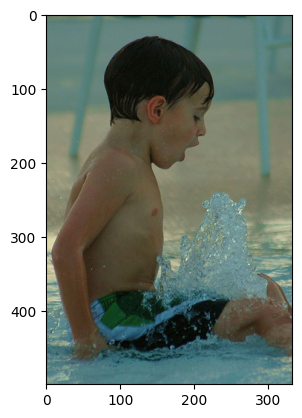

Real Caption-1: a boy sitting in water .
Real Caption-2: a small boy is sitting in the water and water is splashing up through his legs .
Real Caption-3: a young boy in a swimming suit sits in water .
Real Caption-4: a young boy sitting on a water jet in a pool .
Real Caption-5: little boy sitting in water with a fountain coming up through his lap .
Predicted Caption:  two boys playing in the mud


---------
384577800_fc325af410.jpg


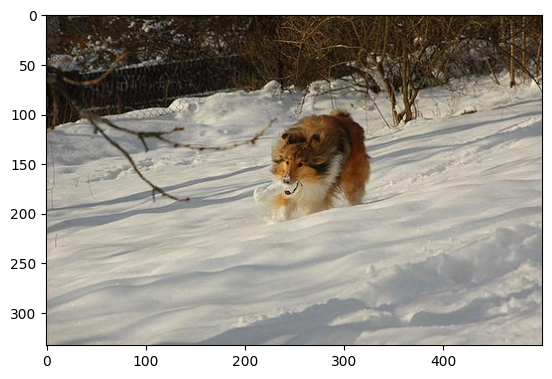

Real Caption-1: a brown dog carries an object in its mouth on a snowy hillside .
Real Caption-2: a collie running through the snow .
Real Caption-3: a sheltie dog carries a white-colored toy in its mouth as it walks across the snow .
Real Caption-4: dog with a toy in the snow .
Real Caption-5: the dog wades through deep snow with something in its mouth .
Predicted Caption:  dog runs through the snow


---------
2148916767_644ea6a7fa.jpg


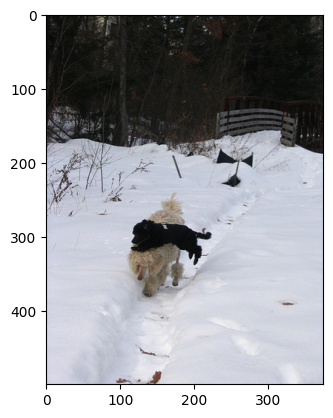

Real Caption-1: a black and white dog playing in the snow together
Real Caption-2: a black poodle jumping on the head of a white poodle while walking in the snow .
Real Caption-3: black dog jumping over a white dog in a snowy path .
Real Caption-4: two dogs playing in the snow .
Real Caption-5: two poodles are running through the snow .
Predicted Caption:  dog runs through the snow


---------
3388330419_85d72f7cda.jpg


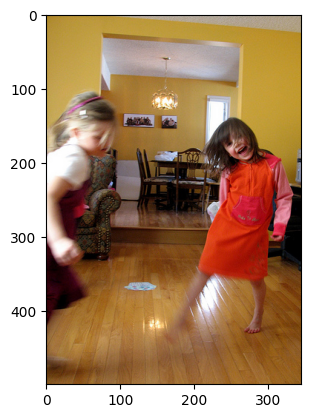

Real Caption-1: children dancing on hardwood flooring .
Real Caption-2: two children are playing or dancing inside .
Real Caption-3: two little girls dance on a hardwood floor in the house .
Real Caption-4: two little girls dancing on the floor
Real Caption-5: two young girls playing in a house .
Predicted Caption:  two young girls are playing with chalk


---------
3502993968_4ee36afb0e.jpg


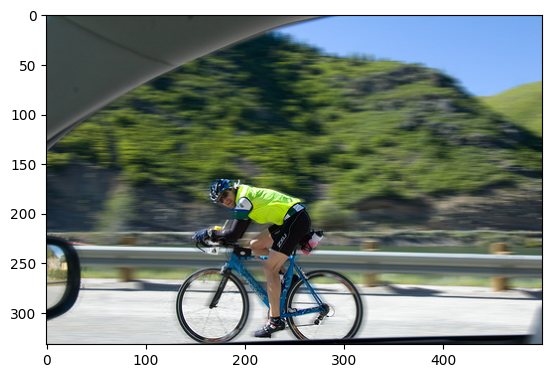

Real Caption-1: a bike rider in green jersey races along a road .
Real Caption-2: a biker looks back at the camera for a photo .
Real Caption-3: a cyclist in a helmet and yellow jersey .
Real Caption-4: a man in a safety vest riding a bicycle on the highway .
Real Caption-5: a man in a yellow shirt riding a blue bicycle moving very fast .
Predicted Caption:  man on bike riding on dirt road


In [47]:
show_image_captions(get_full_path('1287475186_2dee85f1a5.jpg'))
show_image_captions(get_full_path('384577800_fc325af410.jpg'))
show_image_captions(get_full_path('2148916767_644ea6a7fa.jpg'))
show_image_captions(get_full_path('3388330419_85d72f7cda.jpg'))
show_image_captions(get_full_path('3502993968_4ee36afb0e.jpg'))


# Various Random captions



---------
2866254827_9a8f592017.jpg


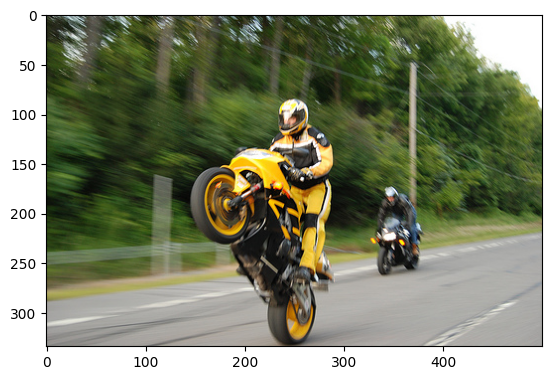

Real Caption-1: a man on a motorcycle riding on his back tire .
Real Caption-2: a man on a yellow sport bike does a wheelie as his friend on a black bike catches up .
Real Caption-3: a yellow motorcyclist is popping a wheelie .
Real Caption-4: the orange rider is driving a motorcycle on one wheel .
Real Caption-5: two motorcyclists on a blurry road , one rider doing a wheelie .
Predicted Caption:  man in red and black uniform riding motorcycle


---------
429851331_b248ca01cd.jpg


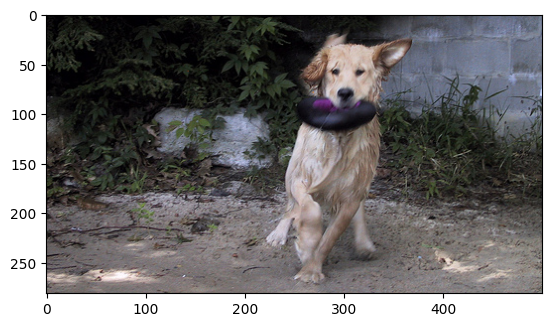

Real Caption-1: a brown dog holding something purple and black in its mouth .
Real Caption-2: a dog catches black frisbee .
Real Caption-3: a large wet yellow dog retrives his toy .
Real Caption-4: dog running with toy .
Real Caption-5: the wet dog catches a toy while playing on the sand .
Predicted Caption:  dog runs through the snow


---------
2991575785_bd4868e215.jpg


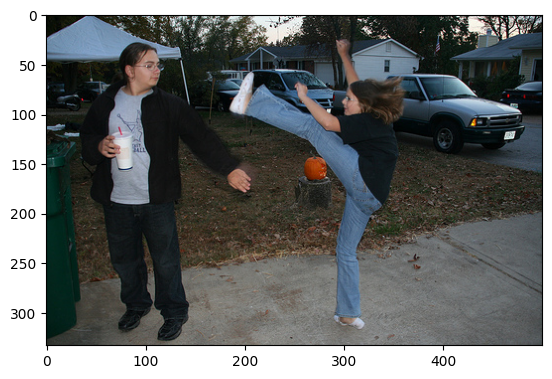

Real Caption-1: a girl doing a kick near a woman .
Real Caption-2: a girl in black high kicks over a jack-o-lantern .
Real Caption-3: a girl in jeans tries to show an adult how high she can kick .
Real Caption-4: a girl kicking her leg up to the shoulder of a woman standing next to her .
Real Caption-5: a woman kicks at a man .
Predicted Caption:  boy in red shirt is playing with an orange bat


---------
3030566410_393c36a6c5.jpg


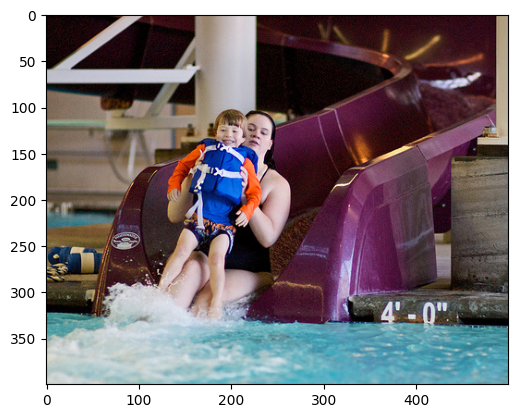

Real Caption-1: a child , held by his mother , slides down a water slide .
Real Caption-2: a woman holding a young boy slide down a water slide into a pool .
Real Caption-3: a woman is holding up a child as they coming splashing down a slide into a pool .
Real Caption-4: a woman is sliding down a water slide with a little boy on her lap .
Real Caption-5: a woman slides down a purple water slide with a small boy on her lap into a pool .
Predicted Caption:  girl in blue suit is jumping into pool


---------
1339596997_8ac29c1841.jpg


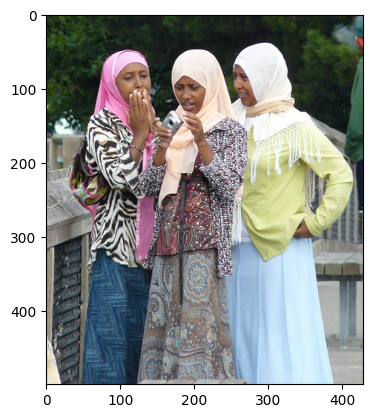

Real Caption-1: three females wearing head scarves standing together
Real Caption-2: three muslim women are looking at a camera .
Real Caption-3: three women in dresses and head scarves outside .
Real Caption-4: three women in head scarves examine a camera .
Real Caption-5: three women with head scarves and long skirts .
Predicted Caption:  woman in white dress and white dress is holding her hand


---------
2813033949_e19fa08805.jpg


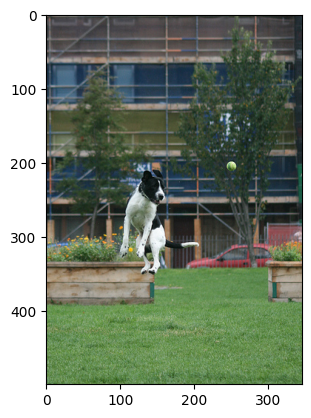

Real Caption-1: a black and white dog jumping for a ball .
Real Caption-2: a black and white dog jumps for a tennis ball .
Real Caption-3: a white and black dog is jumping in the air trying to catch a tennis ball .
Real Caption-4: a white and black dog is playing with a tennis ball near flowers .
Real Caption-5: there is a white and black dog jumping off the ground trying to catch a ball .
Predicted Caption:  black and white dog jumps in the air


---------
241347760_d44c8d3a01.jpg


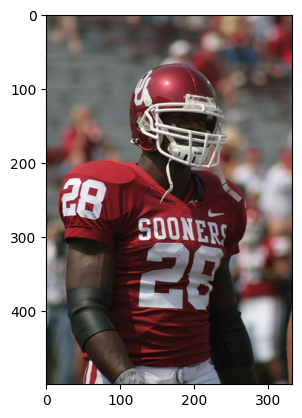

Real Caption-1: a man is wearing a sooners red football shirt and helmet .
Real Caption-2: a oklahoma sooners football player wearing his jersey number 28 .
Real Caption-3: a sooners football player weas the number 28 and black armbands .
Real Caption-4: guy in red and white football uniform
Real Caption-5: the american footballer is wearing a red and white strip .
Predicted Caption:  football player in red and white uniform is tackling the football of the football of the football other of the football other of the other players


---------
3589367895_5d3729e3ea.jpg


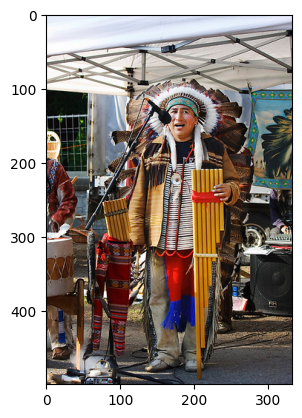

Real Caption-1: a man dressed as an indian , speaking into a microphone
Real Caption-2: a native american stands at a microphone ready to play his instrument .
Real Caption-3: an indian chief in full dress .
Real Caption-4: indian wearing headgear speaks
Real Caption-5: the man dressed liked an indian wearing feathers is standing in front of the microphone .
Predicted Caption:  people are sitting in front of tent


---------
3388330419_85d72f7cda.jpg


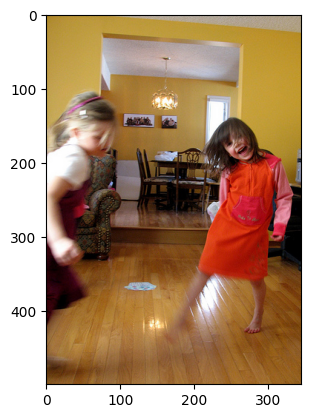

Real Caption-1: children dancing on hardwood flooring .
Real Caption-2: two children are playing or dancing inside .
Real Caption-3: two little girls dance on a hardwood floor in the house .
Real Caption-4: two little girls dancing on the floor
Real Caption-5: two young girls playing in a house .
Predicted Caption:  two young girls are playing with chalk


---------
317109978_cb557802e1.jpg


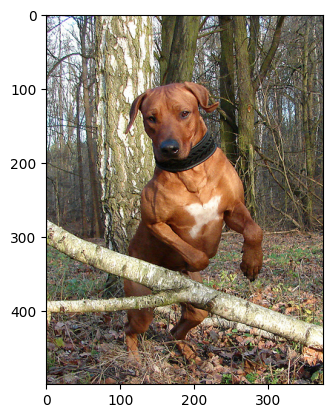

Real Caption-1: a brown and white pitbull , with a black collar , is about to leap over a branch
Real Caption-2: a brown dog climbs over a fallen branch in a wooded area .
Real Caption-3: a brown dog hops over a fallen tree branch .
Real Caption-4: a brown dog is jumping over a tree limb in a wooded area .
Real Caption-5: brown dog with white mark in chest and black collar going over a limb on ground .
Predicted Caption:  brown dog is running through the woods


---------
3393343330_b13df4d8ec.jpg


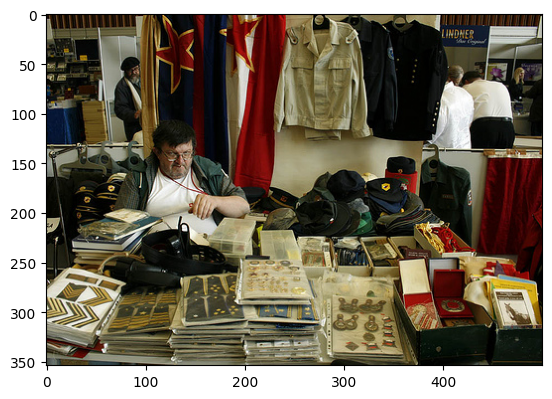

Real Caption-1: a large man sits in a military accessories store .
Real Caption-2: a man in glasses is sitting behind a table laden with military memorabilia .
Real Caption-3: a man is sitting at a table full of military items and clothing .
Real Caption-4: a man sits at a table crowded with military merchandise .
Real Caption-5: veteran shows off different things from a war .
Predicted Caption:  man sits on table in front of store


---------
2928152792_b16c73434a.jpg


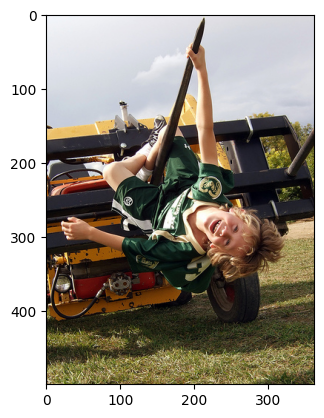

Real Caption-1: a boy in a green soccer outfit hangs from a machine .
Real Caption-2: a boy in a green soccer uniform hangs upside down from a farm vehicle .
Real Caption-3: a child hanging from a hay bale loader .
Real Caption-4: a young boy is tilted over on a cart smiling at the camera
Real Caption-5: the girl is hanging off of the tractor equipment .
Predicted Caption:  four people are playing on the ground


---------
2861932486_52befd8592.jpg


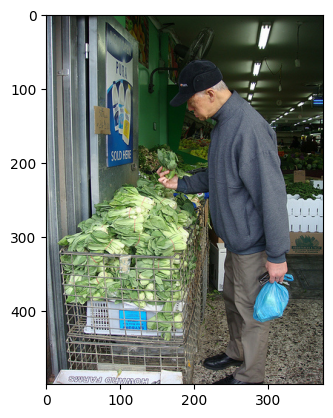

Real Caption-1: a ban in a grey swaetshirt picks out greens in a supermarket .
Real Caption-2: a man is taking a look at the food products .
Real Caption-3: a man looking at produce .
Real Caption-4: a man shopping for fresh lettuce in a market
Real Caption-5: an older man examines produce .
Predicted Caption:  man sits in front of tent


---------
766099402_cdda6964f0.jpg


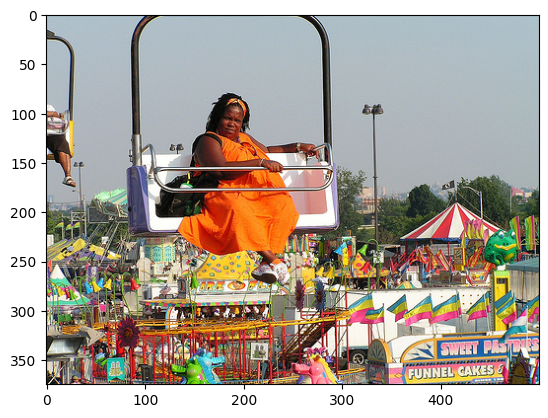

Real Caption-1: a lady in an orange dress rides a ride at the fair .
Real Caption-2: a woman in an orange dress riding a carnival ride .
Real Caption-3: a woman sits alone at a carnival in a lift .
Real Caption-4: a woman wearing an orange dress makes a face while riding above the fair .
Real Caption-5: the woman is wearing an orange dress riding on the ferris wheel .
Predicted Caption:  young man in white shirt is swinging on stage


---------
3299820401_c2589186c5.jpg


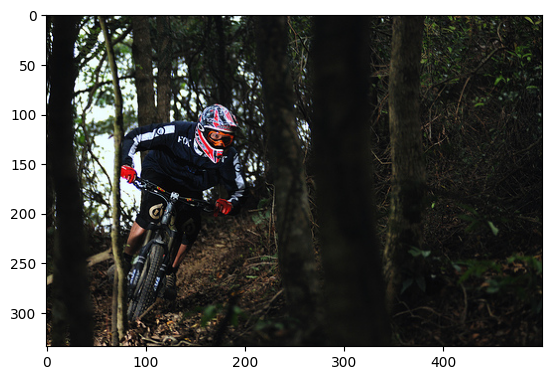

Real Caption-1: a dirt biker rides through some trees .
Real Caption-2: a man is riding a mountain bike through woodland .
Real Caption-3: a mountain biker is racing through a shaded trail .
Real Caption-4: a mountain biker wearing a colorful helmet rides downhill .
Real Caption-5: mountain biker in red striped helmet rides through the trees .
Predicted Caption:  man on bike riding down dirt road


---------
820169182_f5e78d7d19.jpg


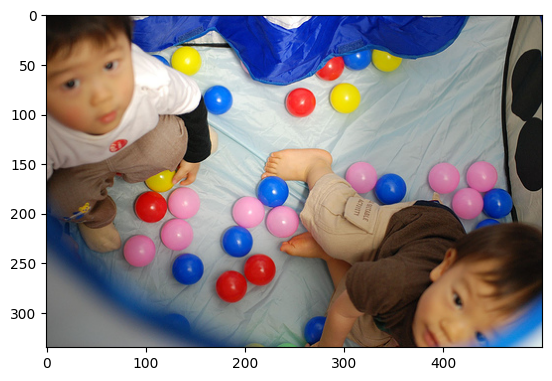

Real Caption-1: two babies look up while they are playing in a playpen with a lot of balls .
Real Caption-2: two boys in tent-like area , with colorful balls on floor .
Real Caption-3: two children look up .
Real Caption-4: two kids are in a pen playing with colorful balls .
Real Caption-5: two young children play with colored balls .
Predicted Caption:  two children play in the air


---------
491405109_798222cfd0.jpg


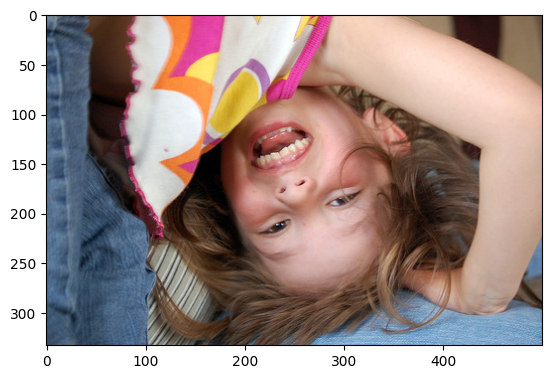

Real Caption-1: a girl poses with her head upside down .
Real Caption-2: a little girl hangs her head upside down .
Real Caption-3: a small girl is doing a handstand while smiling
Real Caption-4: a upside down girl 's face .
Real Caption-5: a young girl smiling with her head upside down
Predicted Caption:  young girl in red shirt and white shorts is jumping on the camera


---------
3456362961_d8f7e347a8.jpg


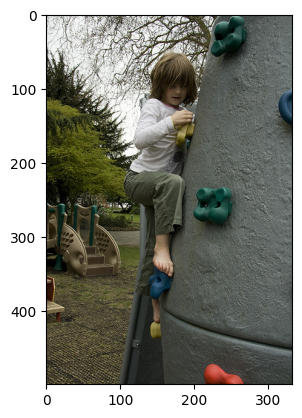

Real Caption-1: a barefoot child climbs at the jungle gym .
Real Caption-2: a little girl climbs up a rock climbing jungle gym at a park .
Real Caption-3: a young child climbing a rock wall at a playground .
Real Caption-4: girl climbing on a climbing wall
Real Caption-5: the little girl is climbing a wall in the park barefoot .
Predicted Caption:  young girl in red shirt and white pants sits on the ground


---------
498444334_a680d318a1.jpg


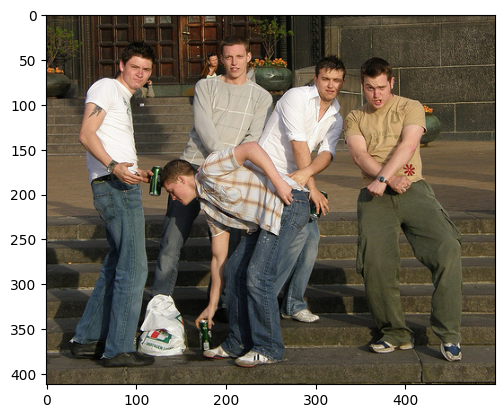

Real Caption-1: a group of young men clowning around while enjoying a beverage .
Real Caption-2: five men pose awkwardly on steps .
Real Caption-3: five young men pose on the steps .
Real Caption-4: four boys posing while one boy sets his drink down .
Real Caption-5: group of young men posing and holding cans .
Predicted Caption:  group of people sit on bench


---------
1764955991_5e53a28c87.jpg


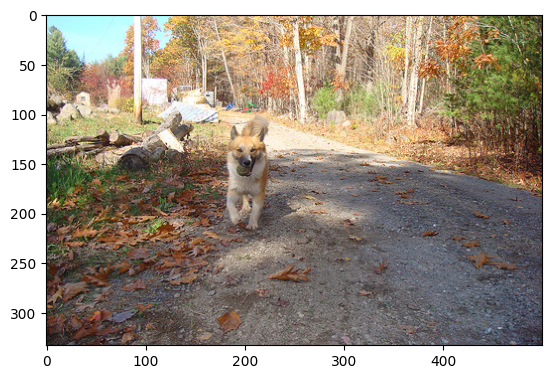

Real Caption-1: a brown and white dog trotting down the road in autumn .
Real Caption-2: a brown dog is carrying a ball up the road .
Real Caption-3: a dog with a ball in his mouth running down a road covered in leaves .
Real Caption-4: a large dog walks along a gravel path in the woods .
Real Caption-5: a tan and white dog retrieving a ball on a gravel path .
Predicted Caption:  dog runs through the snow


In [48]:
show_captions(k=20)



---------
2922973230_5a769ef92a.jpg


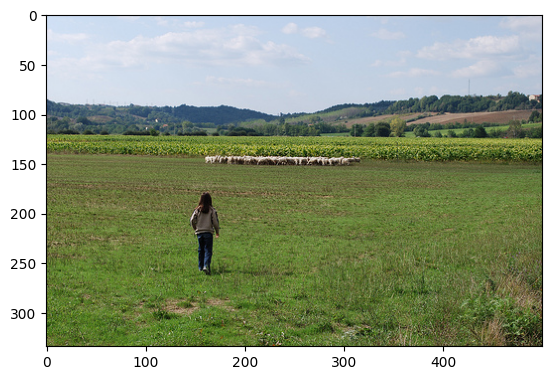

Real Caption-1: a female walking through grass .
Real Caption-2: a girl going towards a heard of sheep .
Real Caption-3: a girl walks toward a herd of sheep in the distance .
Real Caption-4: a girl walks towards some sheep in a grassy valley .
Real Caption-5: a woman walks to the cows .
Predicted Caption:  woman and woman are walking on the beach


---------
543007912_23fc735b99.jpg


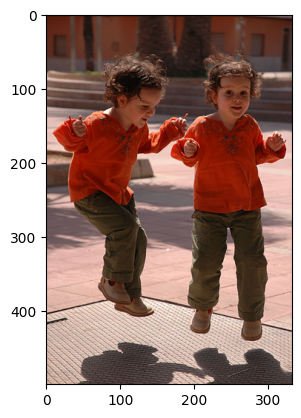

Real Caption-1: twin girls in orange shirts and green pants are jumping .
Real Caption-2: twins in orange shirts jumping on a trampoline .
Real Caption-3: two girls with orange shirts .
Real Caption-4: two identically dressed young children jump outside .
Real Caption-5: two young twin girls in matching green and orange outfits jump in the air .
Predicted Caption:  two children are playing with toy


---------
106490881_5a2dd9b7bd.jpg


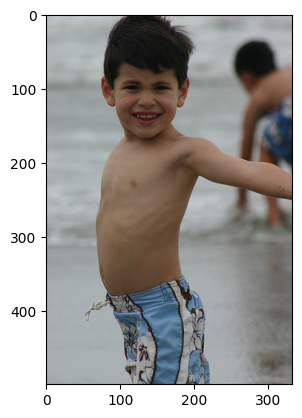

Real Caption-1: a boy in his blue swim shorts at the beach .
Real Caption-2: a boy smiles for the camera at a beach .
Real Caption-3: a young boy in swimming trunks is walking with his arms outstretched on the beach .
Real Caption-4: children playing on the beach .
Real Caption-5: the boy is playing on the shore of an ocean .
Predicted Caption:  young boy in shorts is standing on the beach


---------
3609645320_815c294b65.jpg


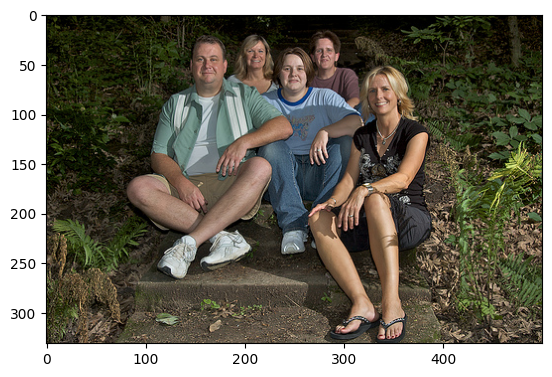

Real Caption-1: a family poses seated on concrete steps .
Real Caption-2: a family sits for a picture on a staircase outside .
Real Caption-3: a group of people are sitting on the steps outside .
Real Caption-4: a group of people sit on the cement steps in the woods and smile .
Real Caption-5: these five people are seated on steps outdoors .
Predicted Caption:  four young boys sitting on the ground


---------
460935487_75b2da7854.jpg


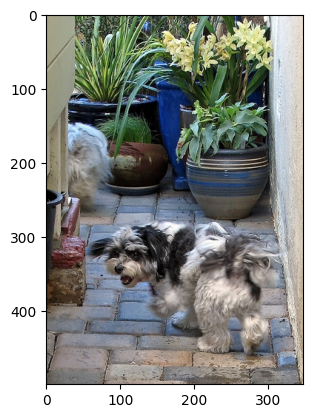

Real Caption-1: a black and white dog is running up a path towards some potted plants .
Real Caption-2: a dog follows another dog around the corner but looks back .
Real Caption-3: a dog is turns back toward the camera near some potted plants .
Real Caption-4: a dog turning to look at the camera .
Real Caption-5: a white and black dog in a hallway filled with potted plants .
Predicted Caption:  dog is standing on the ground


---------
3398746625_5199beea71.jpg


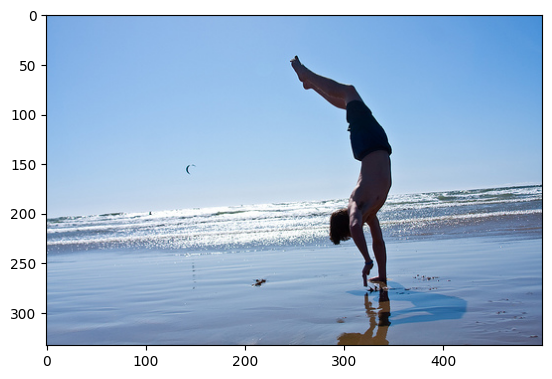

Real Caption-1: a man does a handstand in the sand .
Real Caption-2: a man doing a handstand in shallow water on the beach .
Real Caption-3: a man is performing a handstand on the beach .
Real Caption-4: a topless male does a handstand on a beach .
Real Caption-5: the male is doing a handstand on the wet sand at the edge of the water at the beach .
Predicted Caption:  woman in white suit is walking on the beach


---------
1332722096_1e3de8ae70.jpg


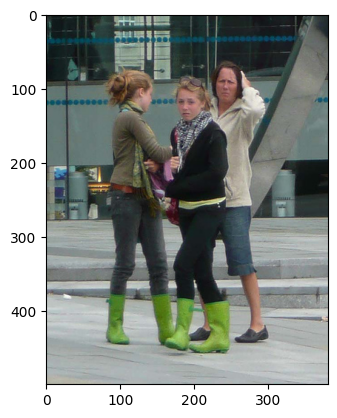

Real Caption-1: three women standing on a city street .
Real Caption-2: three women walk down the street .
Real Caption-3: two girls and a woman walking on the sidewalk
Real Caption-4: two girls in bright green boots and a woman are together .
Real Caption-5: two young ladies in green boots are walking through an urban area while an older lady wearing black shoes follows them .
Predicted Caption:  man in black shirt and black pants walks down the street


---------
3186073578_6e115f45f5.jpg


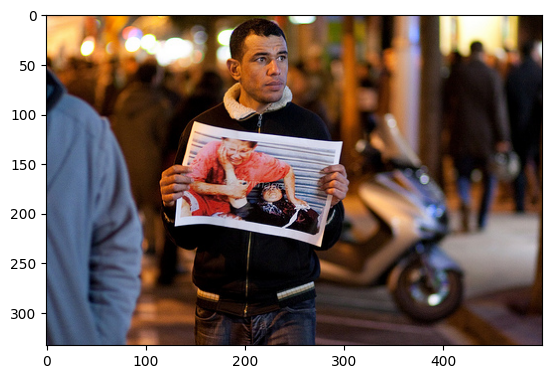

Real Caption-1: a man displays a photograph .
Real Caption-2: a man holding up a picture of two people suffering
Real Caption-3: a man is holding up a small poster with two people in it .
Real Caption-4: a man is standing in front of a motor-scooter holding up a picture .
Real Caption-5: a man is walking down the street holding up a picture .
Predicted Caption:  woman in white shirt is taking picture of people


---------
1119015538_e8e796281e.jpg


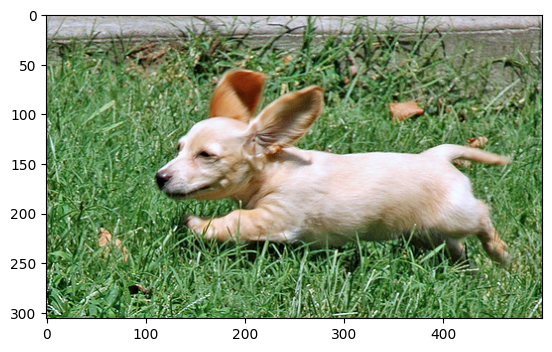

Real Caption-1: a little tan dog with large ears running through the grass .
Real Caption-2: a playful dog is running through the grass .
Real Caption-3: a small dogs ears stick up as it runs in the grass .
Real Caption-4: the small dog is running across the lawn .
Real Caption-5: this is a small beige dog running through a grassy field
Predicted Caption:  white dog is running on the grass


---------
872622575_ba1d3632cc.jpg


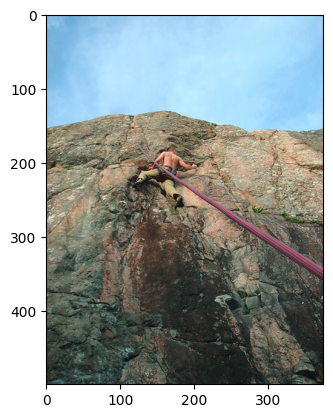

Real Caption-1: a man climbing a mountain .
Real Caption-2: a man climbs a mountain .
Real Caption-3: a man is climbing the side of a mountain .
Real Caption-4: a shirtless man climbs up a steep mountain .
Real Caption-5: a young white man is climbing a mountain with a rope as a guide .
Predicted Caption:  two people are hanging up up rock


---------
497791037_93499238d8.jpg


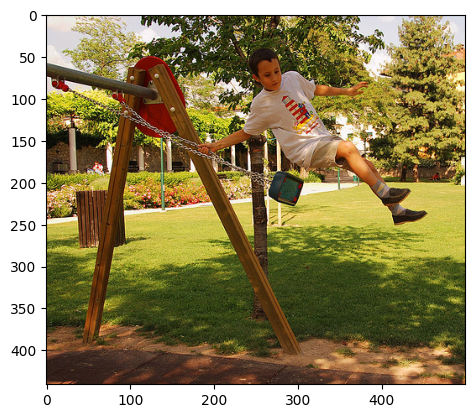

Real Caption-1: a boy jumping off a swing
Real Caption-2: a boy jumps off a swing on the swing set when its high enough .
Real Caption-3: a child in a white shirt coming out of a swing in midair .
Real Caption-4: a young boy leaps off a swing .
Real Caption-5: the boy wearing white is leaping from the swing .
Predicted Caption:  girl in red shirt swings on swing


---------
2358561039_e215a8d6cd.jpg


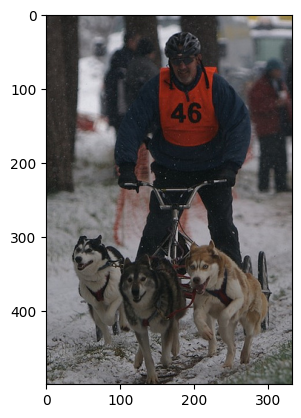

Real Caption-1: a froup of sled dogs pulling a man wearing an orange vest .
Real Caption-2: a three dog sled team pulls an unusual tricycle sled .
Real Caption-3: several dogs carry a man with a helmet through snow .
Real Caption-4: the dogs are pulling a man on a type of bike , through the snow .
Real Caption-5: three dogs pulling a man on a bicycle through the snow .
Predicted Caption:  sled sled in the snow


---------
1258913059_07c613f7ff.jpg


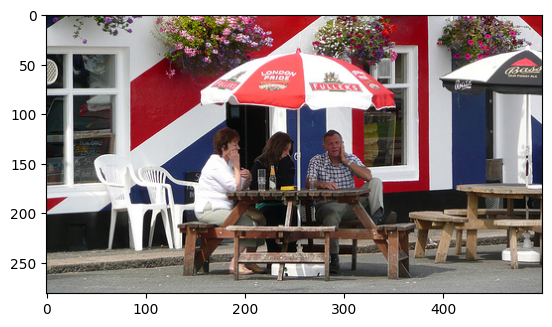

Real Caption-1: a couple of people sit outdoors at a table with an umbrella and talk .
Real Caption-2: three people are sitting at an outside picnic bench with an umbrella .
Real Caption-3: three people sit at an outdoor cafe .
Real Caption-4: three people sit at an outdoor table in front of a building painted like the union jack .
Real Caption-5: three people sit at a picnic table outside of a building painted like a union jack .
Predicted Caption:  people are sitting on stage in front of an audience


---------
448658518_eec0b648a6.jpg


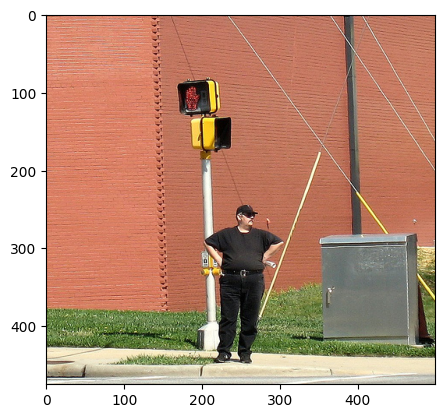

Real Caption-1: a large man dressed in black on a street corner by a red brick building .
Real Caption-2: a man dressed in black is waiting at a crosswalk .
Real Caption-3: a man dressed in black stands at a street corner near a crossing light .
Real Caption-4: a man stands at a traffic light , waiting to cross the street .
Real Caption-5: man in black waits at crossing signal near large brick building .
Predicted Caption:  two men are playing on stage


---------
3589367895_5d3729e3ea.jpg


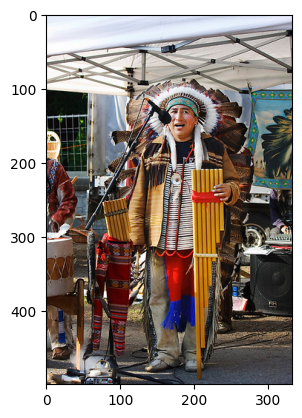

Real Caption-1: a man dressed as an indian , speaking into a microphone
Real Caption-2: a native american stands at a microphone ready to play his instrument .
Real Caption-3: an indian chief in full dress .
Real Caption-4: indian wearing headgear speaks
Real Caption-5: the man dressed liked an indian wearing feathers is standing in front of the microphone .
Predicted Caption:  people are sitting in front of tent


---------
2238019823_79318d1f11.jpg


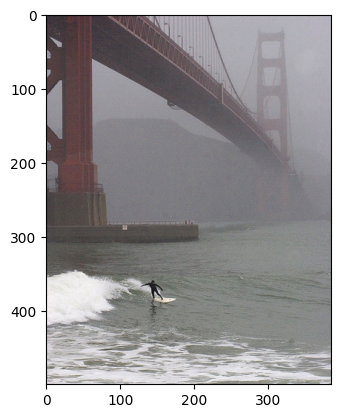

Real Caption-1: a man surfs by the golden gate bridge on a foggy day .
Real Caption-2: a surfer rides a wave under a red bridge .
Real Caption-3: a surfer by a bridge in foggy conditions
Real Caption-4: a surfer under a bridge .
Real Caption-5: man surfing under the golden gate bridge on a foggy day .
Predicted Caption:  person is riding on wave


---------
3545586120_283d728a97.jpg


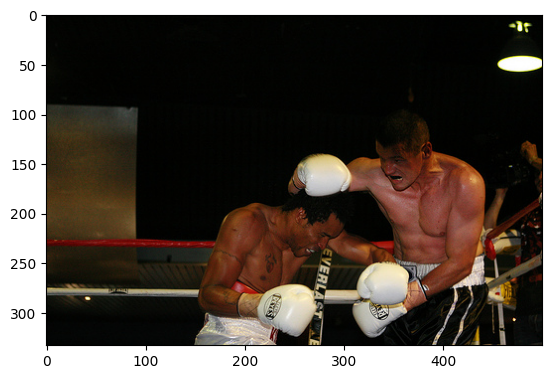

Real Caption-1: the taller man is trying to block the shorter man .
Real Caption-2: two boxers fiercely attacking each other .
Real Caption-3: two boxers with white gloves are fighting .
Real Caption-4: two men wearing white boxing gloves are in a ring .
Real Caption-5: two men with white gloves box in a dimly lit boxing rink .
Predicted Caption:  two men are playing on the ground


---------
2594902417_f65d8866a8.jpg


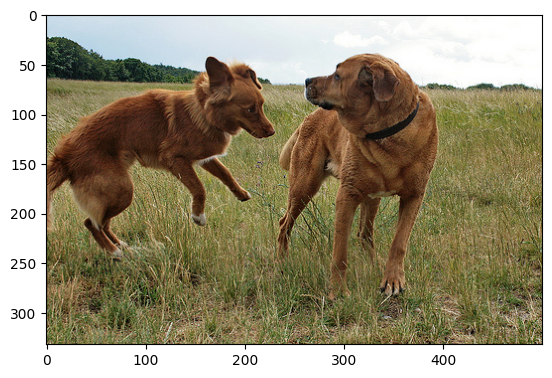

Real Caption-1: a dog hops in a field while another dog stands next to it .
Real Caption-2: one dog is jumping up at another dog in a grassy field .
Real Caption-3: the two tan colored dogs are in a field , and one is jumping in the air .
Real Caption-4: two brown dogs in a field .
Real Caption-5: two brown dogs play with one another in the field .
Predicted Caption:  two dogs run through the grass


---------
2479162876_a5ce3306af.jpg


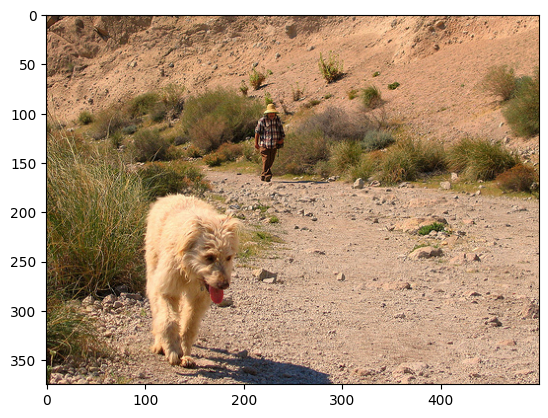

Real Caption-1: a dog walks down the dirt road as a person follows .
Real Caption-2: a tan dog walks ahead of a man in a dry area .
Real Caption-3: a white dog is going for a walk through the desert with its owner .
Real Caption-4: a yellow dog is walking along a mountain trail
Real Caption-5: dog in desert area with distant man in background .
Predicted Caption:  the white dog dog is running through the dirt


---------
3387542157_81bfd00072.jpg


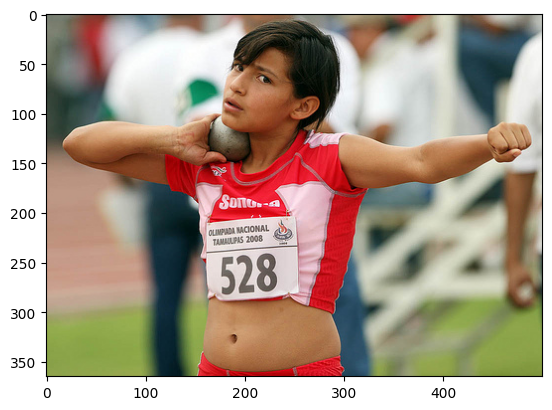

Real Caption-1: a dark-haired young woman , number 528 , wearing red and white , is preparing to throw a shot put .
Real Caption-2: a girl is curling in a competition .
Real Caption-3: athletic woman in red and white uniform throwing shot put .
Real Caption-4: a woman is about to race around a track .
Real Caption-5: shotput athlete getting ready to throw .
Predicted Caption:  man in red shirt and white shorts is holding camera


In [49]:
show_captions(k=20)



---------
3294209955_a1f1e2cc19.jpg


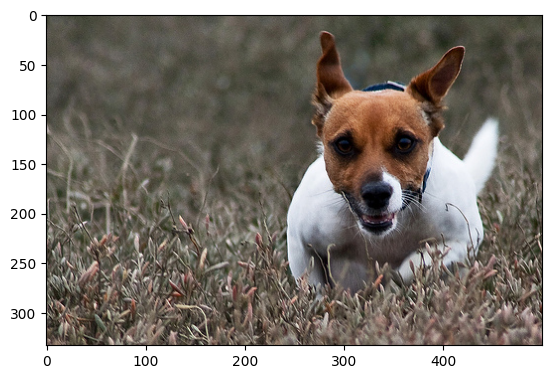

Real Caption-1: a little white and brown dog runs through brown grass .
Real Caption-2: a small dog runs through a field .
Real Caption-3: brown and white dog runs through brush .
Real Caption-4: small dog running through a field .
Real Caption-5: the dog is running full speed through the meadow .
Predicted Caption:  two dogs are running on the grass


---------
3708177171_529bb4ff1d.jpg


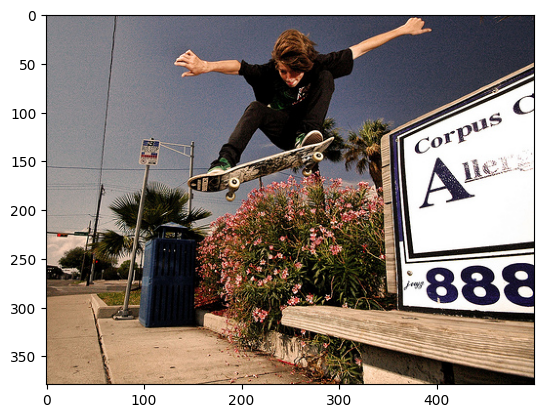

Real Caption-1: a boy is outside jumping over a flower bush on a skateboard .
Real Caption-2: a skateboarder in black clothes jumps over a bench .
Real Caption-3: a skateboarder is performing a jump from a wooden bench .
Real Caption-4: a youth with brown hair is doing an ollie over a bench with his skateboard .
Real Caption-5: skateboarder in the air by a bench with advertisement
Predicted Caption:  boy in green shirt is skateboarding on skateboard


---------
2985679744_75a7102aab.jpg


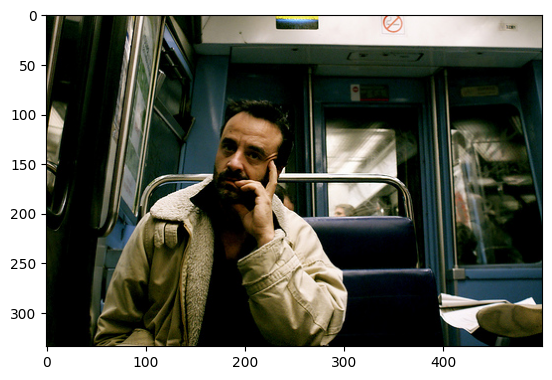

Real Caption-1: a bearded man on a train
Real Caption-2: a man is sitting on a train resting his hand against his face .
Real Caption-3: a man sitting on a subway .
Real Caption-4: a man sitting on a subway looking at the camera .
Real Caption-5: a man sitting on public transportation .
Predicted Caption:  man sits on the street


---------
53043785_c468d6f931.jpg


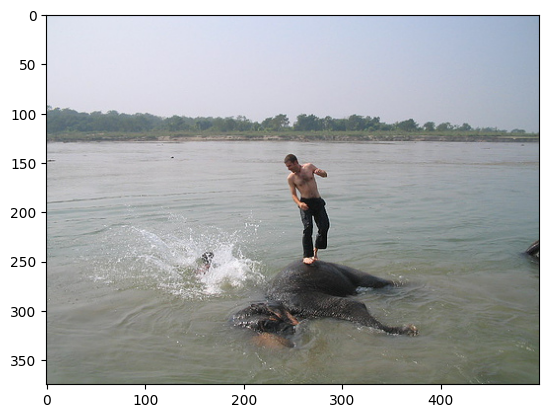

Real Caption-1: a man is standing on an animal in the water .
Real Caption-2: a man is standing on an elephant lying in some water .
Real Caption-3: a man standing on a rock in a river with a spash next to him .
Real Caption-4: a man stands on top of an elephant in the water .
Real Caption-5: a man stands on top of a submerged elephant .
Predicted Caption:  young boy in blue shirt is playing in the ocean


---------
3470951932_27ed74eb0b.jpg


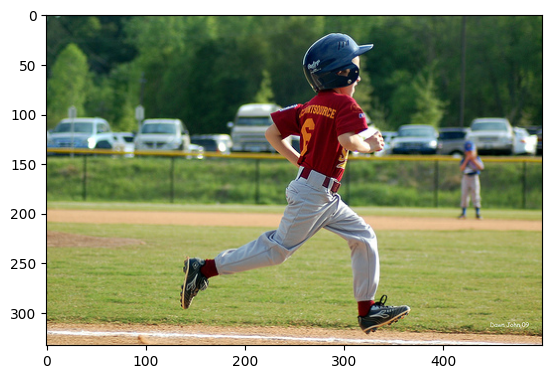

Real Caption-1: a boy in a baseball uniform runs the bases .
Real Caption-2: a boy is running around the bases in a baseball game .
Real Caption-3: a boy runs to a baseball base .
Real Caption-4: a child in a baseball uniform runs on a baseball field .
Real Caption-5: the young baseball player is running to one of the bases .
Predicted Caption:  baseball player in white uniform and white uniform is playing baseball


---------
3259991972_fce3ab18b2.jpg


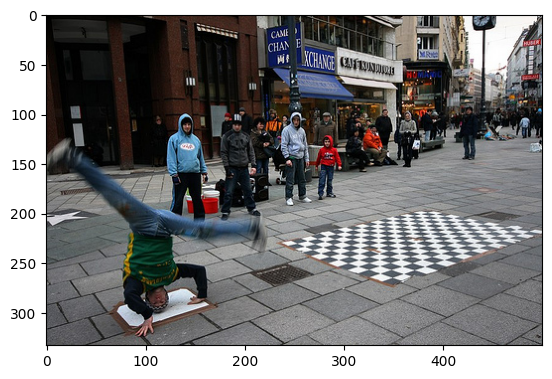

Real Caption-1: a break dancer spins on his head outside as onlookers watch the performance .
Real Caption-2: a man spinning on his head on a city sidewalk near a checkerboard mat .
Real Caption-3: a man stands on his head in front of a crowd .
Real Caption-4: man standing on his head near a black and white pattern in the street .
Real Caption-5: young man break dancing in the street .
Predicted Caption:  man in red shirt is riding skateboard in the street


---------
3334537556_a2cf4e9b9a.jpg


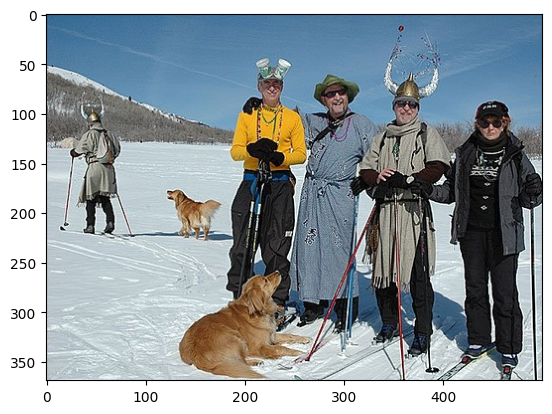

Real Caption-1: a group of people on skis with two dogs .
Real Caption-2: a man dressed in a horned hat poses for a picture on skis with three other people and a dog .
Real Caption-3: four people holding each others shoulders with a brown dog in front of them , standing on snow .
Real Caption-4: people dressed in costumes are on skis .
Real Caption-5: people , some dressed in costumes , and dogs on a snowy mountain .
Predicted Caption:  group of people are walking in the snow


---------
1287475186_2dee85f1a5.jpg


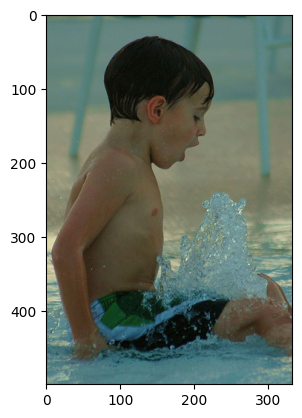

Real Caption-1: a boy sitting in water .
Real Caption-2: a small boy is sitting in the water and water is splashing up through his legs .
Real Caption-3: a young boy in a swimming suit sits in water .
Real Caption-4: a young boy sitting on a water jet in a pool .
Real Caption-5: little boy sitting in water with a fountain coming up through his lap .
Predicted Caption:  two boys playing in the mud


---------
2549968784_39bfbe44f9.jpg


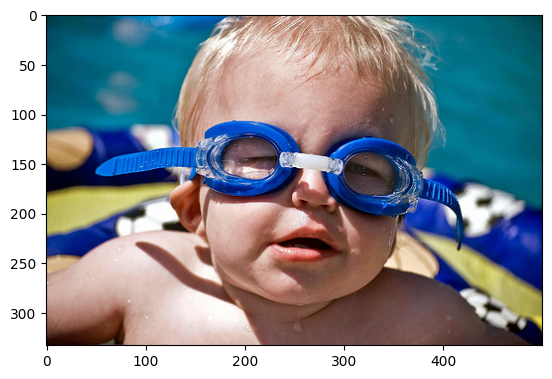

Real Caption-1: a child wearing swim goggles .
Real Caption-2: a small child wears goggles near a pool .
Real Caption-3: a young child is wearing blue goggles and sitting in a float in a pool .
Real Caption-4: a young child wearing blue goggles sits on a raft in a swimming pool .
Real Caption-5: the little child is wearing blue goggles .
Predicted Caption:  young girl in blue shirt is sliding down in the pool


---------
2581066814_179d28f306.jpg


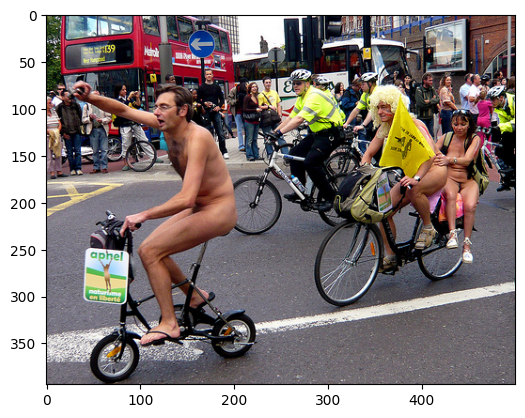

Real Caption-1: a group of people who are naked and riding bikes in the streets .
Real Caption-2: a naked man rides a bike .
Real Caption-3: naked people riding bikes .
Real Caption-4: the man leading cyclist through the city streets is butt naked .
Real Caption-5: three naked people ride bicycles in a city street while law enforcement and a crowd looks on .
Predicted Caption:  man riding on bike


---------
1174629344_a2e1a2bdbf.jpg


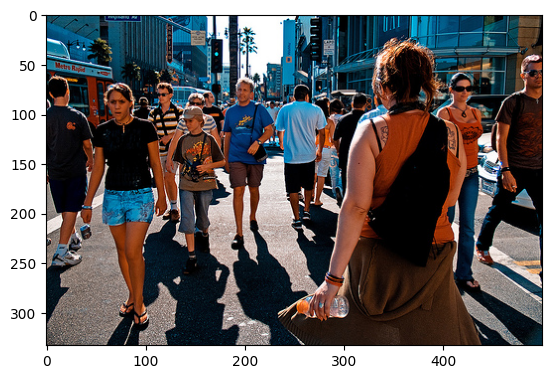

Real Caption-1: a crowd of people walk down a busy sidewalk .
Real Caption-2: a group of different people are walking in all different directions in a city .
Real Caption-3: a group of people walking a city street in warm weather .
Real Caption-4: busy intersection in the summer time in a city
Real Caption-5: people in summer clothes are walking on the sidewalk of a large city .
Predicted Caption:  people walking down street


---------
2192131110_8a40e7c028.jpg


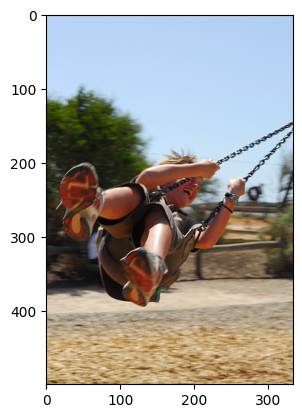

Real Caption-1: a lady is swinging and smiling .
Real Caption-2: a person swinging on a swing
Real Caption-3: kid swinging on a swing
Real Caption-4: person on swing
Real Caption-5: this girl is having so much fun on the swing !
Predicted Caption:  girl in red shirt and white hat is swinging


---------
3315616181_15dd137e27.jpg


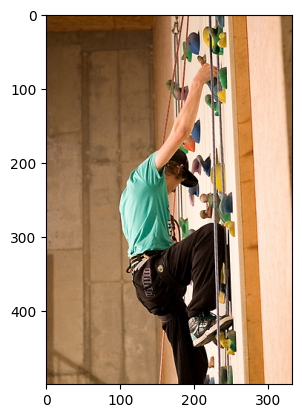

Real Caption-1: a man in a green shirt climbs an indoor climbing wall .
Real Caption-2: a man in a green shirt is climbing an obstacle course .
Real Caption-3: a teenage boy climbs an indoor climbing wall .
Real Caption-4: a teenager climbs a rock wall .
Real Caption-5: someone climbs an indoor climbing wall .
Predicted Caption:  boy in black shirt is skateboarding on skateboard


---------
2913965136_2d00136697.jpg


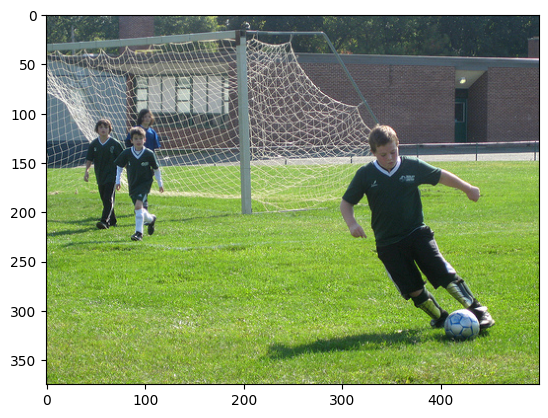

Real Caption-1: a boy in a green uniform is kicking a soccer ball in a game while two others stand behind him .
Real Caption-2: boys play soccer near a goal post .
Real Caption-3: some children are playing soccer on a sports-field by the goal .
Real Caption-4: the little boy gets ready to kick the soccer ball .
Real Caption-5: three boys play soccer .
Predicted Caption:  two boys playing soccer


---------
2484190118_e89363c465.jpg


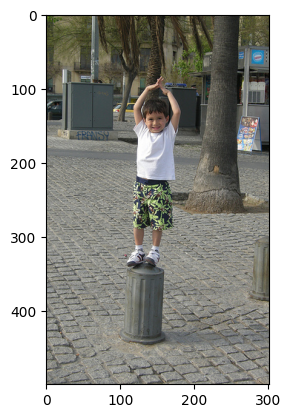

Real Caption-1: a boy with his hands above his head stands on a cement pillar above the cobblestones .
Real Caption-2: a child in colorful shorts is standing on a post in the street .
Real Caption-3: a small boy stands on a cement stump in a park with his hands on his head .
Real Caption-4: a young man wearing a white t-shirt and green and black shorts standing on a stump .
Real Caption-5: small child in white shirt and print shorts with hands over their head standing on object .
Predicted Caption:  young girl in pink shirt and white pants is jumping on trampoline


---------
3100251515_c68027cc22.jpg


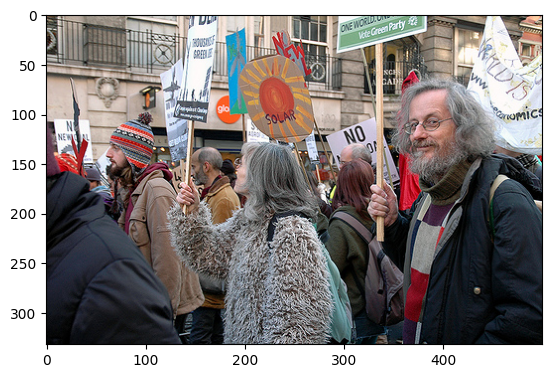

Real Caption-1: a crowd of people wearing jackets and holding signs .
Real Caption-2: a group of protesters picket in the road .
Real Caption-3: a large " green " peaceful protest is taken to the streets .
Real Caption-4: a protest march is passing by a white stone building .
Real Caption-5: group of people walking with posters .
Predicted Caption:  people are wearing red costumes and hats


---------
3227148358_f152303584.jpg


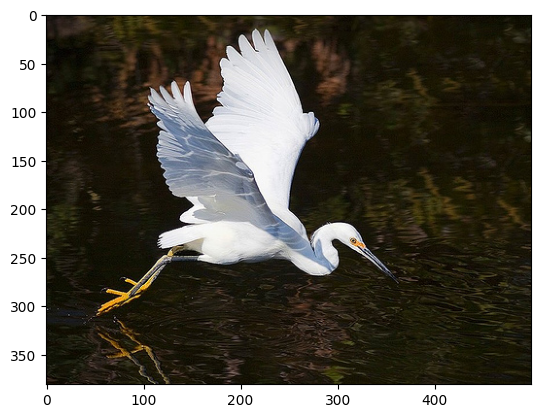

Real Caption-1: a bird flies above the water .
Real Caption-2: a heron is flying through the air near foliage .
Real Caption-3: a large white bird flying over water .
Real Caption-4: a large white bird swoops over water .
Real Caption-5: a white bird with yellow feet is flying over water .
Predicted Caption:  white and white bird bird is flying over the water


---------
3365783912_e12c3510d8.jpg


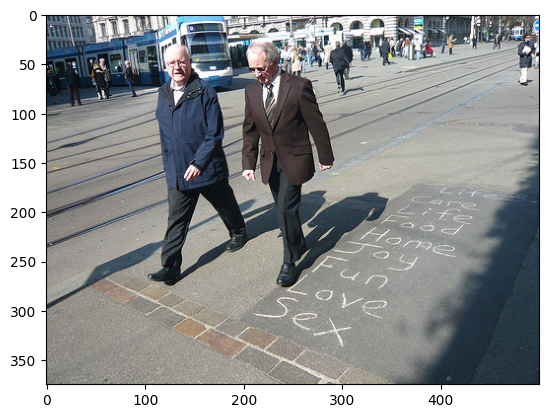

Real Caption-1: two elderly people walk down a city sidewalk by words written in chalk .
Real Caption-2: two men walk along a busy city street with words printed on the sidewalk .
Real Caption-3: two men walk through a city with words on the street .
Real Caption-4: two older men in business attire are walking in a city , text graffiti is visible on the sidewalk .
Real Caption-5: two people walk down a city street that has writing on it .
Predicted Caption:  man in black shirt and black pants walks down the street


---------
3145967309_b33abe4d84.jpg


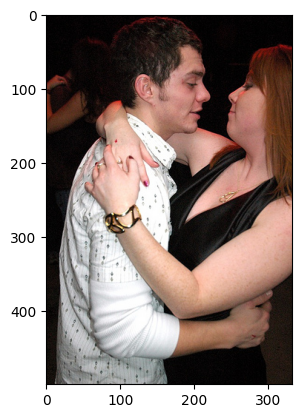

Real Caption-1: a couple in an embrace looking at each other .
Real Caption-2: a man and woman are dancing nearby others who are doing the same .
Real Caption-3: a man in a white print shirt and a woman in a black dress dancing .
Real Caption-4: a man in a white shirt is dancing with a woman in black .
Real Caption-5: the red haired woman in the black dress has her arms around a man in white .
Predicted Caption:  man in black shirt is holding baby in black shirt


---------
3200120942_59cfbb3437.jpg


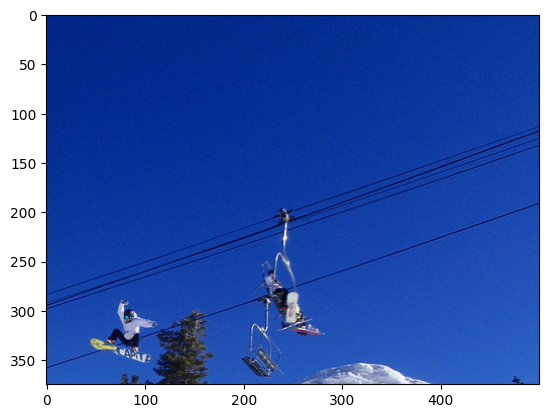

Real Caption-1: a snowboarder is jumping in the air next to the ski lift .
Real Caption-2: a snowboarder jumping in the air with a person riding a ski lift in the background
Real Caption-3: one person is on a ski lift while another snowboards .
Real Caption-4: people on a ski lift .
Real Caption-5: snowboarders sit on a chairlift .
Predicted Caption:  person is riding on dirt track


In [50]:
show_captions(k=20)

# Metric Calculations

In [51]:
evaluate = Evaluate(loaded_model,model_training_params,imageCaptionDataset)
evaluate.dump_image_caption()
evaluate.calculate_metrics()

Streaming output truncated to the last 5000 lines.
Time  taken for caption generation  3416091866_a96003d652.jpg: 0.00s
Extracting caption for with   1282392036_5a0328eb86.jpg
Extracting caption for with  index  4286
caption is  woman in white shirt is sitting on the street
BLEU Score is.... 0.5142002922883543
ROUGE Score is.... {'rouge1': Score(precision=0.2222222222222222, recall=0.14285714285714285, fmeasure=0.17391304347826086), 'rougeL': Score(precision=0.2222222222222222, recall=0.14285714285714285, fmeasure=0.17391304347826086)}
METEOR Score is.... 0.13020833333333334
Time  taken for caption generation  1282392036_5a0328eb86.jpg: 0.00s
Extracting caption for with   2929506802_5432054d77.jpg
Extracting caption for with  index  4287
caption is  child sits on swing
BLEU Score is.... 0.19529803374503985
ROUGE Score is.... {'rouge1': Score(precision=0.25, recall=0.09090909090909091, fmeasure=0.13333333333333333), 'rougeL': Score(precision=0.25, recall=0.09090909090909091, fmeasure=0.

# Conclusion

**BLEU-4 Score is 55.5**



